# Booking.com Job Analysis
***
<p align='center'>
<img src='Images/booking_logo.jpg' style>
</p>

## Introduction
_Passing by the Booking.com offices aboard a ferry on my daily commute I wondered, **what would it take to work for one of the world's biggest travel companies?**_

*I got inspired by their story - growing from a small Dutch startup in 1996 to leading digital travel company, and decided to talk to some of their employees. Throughout these talks it became apparent that their strong focus on creating an environment for learning and experimenting stood at the foundation of creating innovative solutions and value for its customers. These values resonated with me, and helped fuel this experiment.*

*Coming from a background in Architecture I've always had a strong interest in translating questions into insights, taking the conceptual and turning it into reality. But what transferable skills do I have? Seeking out job requirements on the Booking.com career platform it soon became apparent that my passion for data, optimalization, python would be of use. Great, let's apply! Resume and covering letter at the ready, I stumble across their hiring process:*

<p align='center'>
<img src='Images/booking_ai.jpg' style>
</p>

*No cover letter, no person reading resumes, no applying to specific positions. Instead:*

>**We rely on AI to analyze your CV and enrich it with market data to get a well rounded skill set overview. Consequently, your skills will be matched with the best available career opportunity.**

_This sentence sparked my interest and started this project. **What if I could use a data-driven approach to tailor my resume to the positions I'm interested in?**_
***

## Project Objective
To create a clear outline and direction we start with our defining our goal for this project.

**Research Question: What skills and experiences are most relevant for Data-related positions at Booking.com?**

Key questions:
- How many positions are available and how are they segmented?
- What impact does location have on availability and type of job?
- What skills, education, experiences are most coveted by Booking.com?

**Once we've answered these questions we'll continue with predicting what Team a Job Description falls into.**

## Methodology
- Reading in raw data from web scraper
- Cleaning up data / string manipulation
- Exploratory Analysis to understand data
- Delving into specifics to answer key questions
- Ensemble modeling to predict Team

## Data
- All data was obtained through webscraping the [Booking.com career website](https://jobs.booking.com/careers) on 19-02-2022
- Webscraper can be found at [Web Scraper/Web_Scraper_Booking_Career.ipynb](https://github.com/niekvanderzwaag/Booking.com/blob/main/Web%20Scraper/Web_Scraper_Booking_Career.ipynb)
***

# 1. Imports

In [1]:
#Imports
import numpy as np
import pandas as pd
import itertools

#Settings for string legibility
pd.set_option('display.max_rows', 50)
pd.options.display.max_colwidth = 500

#String manipulations
import re, string
from collections import Counter
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords, wordnet
from nltk import pos_tag

#NLTK Packages: Un-comment lines below to download relevant NLTK packages
#import nltk
#nltk.download('punkt')
#nltk.download('stopwords')
#nltk.download('wordnet')
#nltk.download('averaged_perceptron_tagger')
#nltk.download('omw-1.4')

#Visualizations
import matplotlib as mpl
import matplotlib.pyplot as plt
#from matplotlib import cm
from matplotlib.ticker import FormatStrFormatter
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import seaborn as sns

#Plot output
%matplotlib inline
plt.rcParams['figure.figsize'] = [18,10]
plt.rcParams['figure.dpi'] = 150
%config InlineBackend.figure_format = 'svg'

#Booking.com colorscheme RGBA
blue_d = np.array([0/256, 53/256, 128/256, 1])
blue_l = np.array([0/256, 159/256, 227/256, 1])
yellow = np.array([254/256, 186/256, 2/256, 1])
grey = np.array([102/256, 102/256, 102/256, 1])
white = np.array([242/256, 246/256, 250/256, 1])

#Booking.com colormaps (RGBA)
cmap1 = ListedColormap([blue_d])
cmap2 = ListedColormap([blue_d,blue_l])
cmap3 = ListedColormap([blue_d,blue_l,yellow])
cmap4 = ListedColormap([blue_d,blue_l,yellow,grey])
cmap5 = ListedColormap([blue_d,blue_l,yellow,grey,white])

#Booking.com palettes (Hex)
c1 = ['#003580']
c2 = ['#003580', '#009fe3']
c3 = ['#003580', '#009fe3', '#feba02']
c4 = ['#003580', '#009fe3', '#feba02', '#666']
c5 = ['#003580', '#009fe3', '#feba02', '#666', '#f2f6fa']
c15 = ['#003580', '#009fe3', '#feba02', '#D9958D', '#00C4CC', '#77A0D9', '#8CB811', '#F57D00', '#4A8594', '#D52685', '#CE1126', '#553A99', '#D9958D','#0EA013', '#8283FA']

#Booking.com settings Seaborn
sns.set(rc={'axes.facecolor':'#f2f6fa', 'figure.facecolor':'#f2f6fa'})
sns.set_palette(sns.color_palette(c3))

#Wordcloud
from wordcloud import WordCloud

#Quality of Life
import warnings
warnings.filterwarnings('ignore')

# 2. Data

In [2]:
df = pd.read_csv('Booking_Jobs_All_220218.csv')

In [3]:
df.head(3)

,Job Title,Job Description,Location,Team
0,Junior Endpoints Engineer,"Booking.com\nIt wasn’t so long ago that booking a trip to see the Eiffel Tower, stroll down New York’s iconic Madison Avenue or feel the sand between our toes on Copacabana Beach was simply a matter of a few taps on our smartphone.\nIn fact, that’s what we do at Booking.com. We make it easier for everyone to experience the world. And while that world might feel a little farther away right now, we’re busy preparing for when the world is ready to travel once more.\nAcross our offices worldwide...","Manchester, United Kingdom",Engineering
1,UX Writer - B2B,"At Booking.com, data drives our decisions. Technology is at our core. And innovation is everywhere. But our company is more than datasets, lines of code or A/B tests. We’re the thrill of the first night in a new place. The excitement of the next morning. The friends you make. The journeys you take. The sights you see. And the food you sample. Through our products, partners and people, we make it easier for everyone to experience the world.\nWe’re looking for a UX Copywriter to join our writi...","Amsterdam, Netherlands",Design & User Experience
2,Treasury Risk Specialist,"Booking.com’s global treasury team is looking for a Treasury risk management professional to join our growing team. \nThe Treasury Risk Specialist is responsible for performing financial analysis and operating processes relating to the identification, quantification, management and reporting of credit, counterparty, liquidity and other Treasury risk typologies that attach to Booking’s evolving business models, strategic initiatives and third party relationships. \nThe individual will form ...","Amsterdam, Netherlands",Finance


All data was directly scraped from the Booking.com career platform and contains the following: 

Columns:
- **Job Title**: title of position (str)
- **Job Descriptions**: complete description of position (str)
- **Location**: city and country information (str)
- **Team**: team category determined by Booking.com (str)

In [4]:
df.info() #No missing values

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 653 entries, 0 to 652
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Job Title        653 non-null    object
 1   Job Description  653 non-null    object
 2   Location         653 non-null    object
 3   Team             653 non-null    object
dtypes: object(4)
memory usage: 20.5+ KB


# 3. EDA - Numbers

We'll start by getting to know the dataset a bit better through visualizations.

1. Number of Jobs
2. Teams
3. Location
4. Job Description

## 3.1 Number of Jobs

In [5]:
print('Dataframe shape is {}, containing a total of {} jobs'.format(df.shape,df.shape[0]))


Dataframe shape is (653, 4), containing a total of 653 jobs


## 3.2 Teams

In [6]:
df_teams = df.groupby(by=['Team']).count().reset_index()
df_teams.sort_values(by='Job Title', ascending=False, inplace=True)

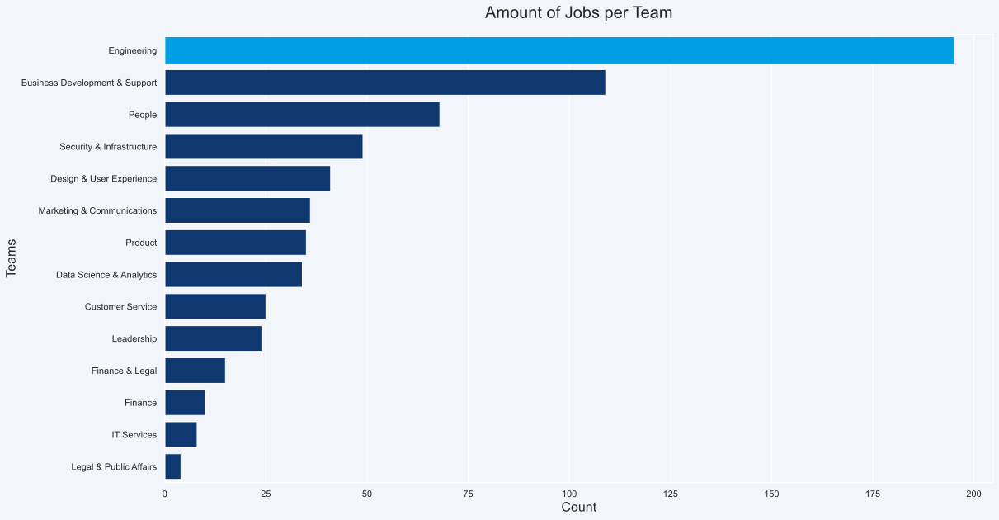

In [7]:
#Plot
ax = sns.barplot(data=df_teams, x='Job Title', y='Team', palette=c1)

#Highlight
for bar in ax.patches:
    if bar.get_y() < 0:
        bar.set_color(blue_l)  

#Labels
plt.xlabel('Count', fontsize=16)
plt.ylabel('Teams', fontsize=16)
plt.title('Amount of Jobs per Team', fontsize=20, pad=20);

In [8]:
print('Out of a total of {} jobs, {:.2f}% ({}) are in Engineering'.format(df['Team'].value_counts().sum(),((df['Team'].value_counts()[0]/df['Team'].value_counts().sum()) * 100),df['Team'].value_counts()[0]))

Out of a total of 653 jobs, 29.86% (195) are in Engineering


##### Inference:
> - Almost **30% of all jobs (195) are in Engineering**, and almost **17%** of jobs (109) are in Business Development & Support
> - Legal & Public Affairs has the fewest jobs at **4**, making up only **0.61%** of all jobs

## 3.3 Location

In [9]:
df['Country'] = df['Location'].apply(lambda x : x.split(', ')[1]) #Picking only Country from Location
df['Country'] = df['Country'].apply(lambda x : x.split(' and ')[0]) #Picking first location if multiple are mentioned

#Only for the US are states mentioned - comparing string length to 2-letter abbriviation and sort into United States
for i in range(df.shape[0]):
    if len(df['Country'][i]) == 2:
        df['Country'][i] = 'United States'

df_location = df.groupby(by=['Country']).count().reset_index()
df_location.sort_values(by='Job Title', ascending=False, inplace=True)

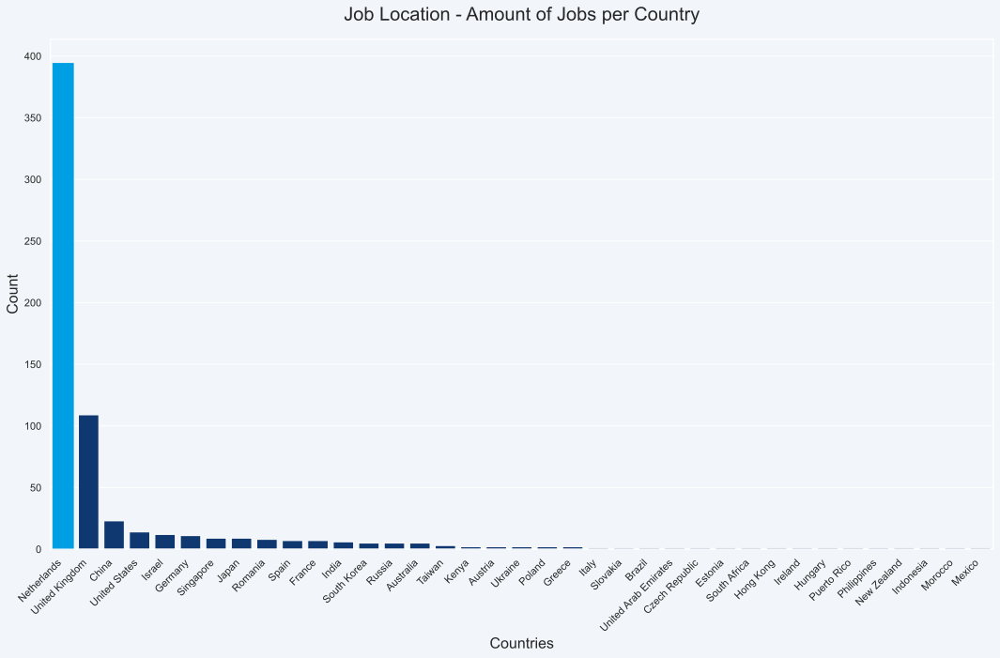

In [10]:
#Plot
ax = sns.barplot(data=df_location, x='Country', y='Job Title', palette=c1)

#Highlight
for bar in ax.patches:
    if bar.get_x() < 0:
        bar.set_color(blue_l)  

#Labels
plt.xticks(rotation = 45, ha= 'right')
plt.xlabel('Countries', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.title('Job Location - Amount of Jobs per Country', fontsize=20, pad=20);

In [11]:
print('Out of a total of {} jobs, {:.2f}% ({}) are located in The Netherlands'.format(df['Country'].value_counts().sum(),((df['Country'].value_counts()[0]/df['Country'].value_counts().sum()) * 100),df['Country'].value_counts()[0]))

Out of a total of 653 jobs, 60.34% (394) are located in The Netherlands


##### Inference:
> - Although Booking.com is a global company, **over 60% of its jobs are based in The Netherlands**

## 3.4 Job Descriptions

In order to dive deeper into the data we need to understand Job Descriptions. This text is at the heart of answering what skills, requirements and responsibilities are demanded to fill a certain positions - and therefor key in answering our own research questions. Unfortunately, all this information is hidden in long texts that make it hard for us (and computers) to make sense of it. In order to measure our progress in making sense of things, we start by creating some measurable features and a baseline against which we can compare our results.

***

### 3.4.1 Baseline & Features

Let's create some general statistical text features form the Job Description.

1. **Word Count** - Total number of words
2. **Character Count** - Total number of characters excluding spaces   
3. **Word Density** - Average length of the words used  
4. **Punctuation Count** - Total number of punctuations used

In [12]:
df['Job Description'] = df['Job Description'].apply(lambda x : re.sub('\\\n',' ', x)) #Replace all newlines
df['R_word_count'] = df['Job Description'].apply(lambda x : len(x.split())) #Splitting strin into words
df['R_char_count'] = df['Job Description'].apply(lambda x : len(x.replace(' ',''))) #Removing spaces and counting characters
df['R_word_density'] = df['R_word_count'] / (df['R_char_count'] + 1) #Devide total words by number of characters
df['R_punc_count'] = df['Job Description'].apply(lambda x : len([a for a in x if a in string.punctuation])) #Count punctuation by comparing to string.punctuation

df_stats_raw = df[['Job Title','R_word_count', 'R_char_count', 'R_word_density', 'R_punc_count']]
df_stats_raw.head()

,Job Title,R_word_count,R_char_count,R_word_density,R_punc_count
0,Junior Endpoints Engineer,962,5727,0.167947,161
1,UX Writer - B2B,687,3757,0.182810,77
2,Treasury Risk Specialist,833,5203,0.160069,106
3,Product Manager - Insurance - Policy Admin,1155,6526,0.176957,116
4,Account Executive - Manchester,549,2923,0.187756,53


### 3.4.2 Word Count

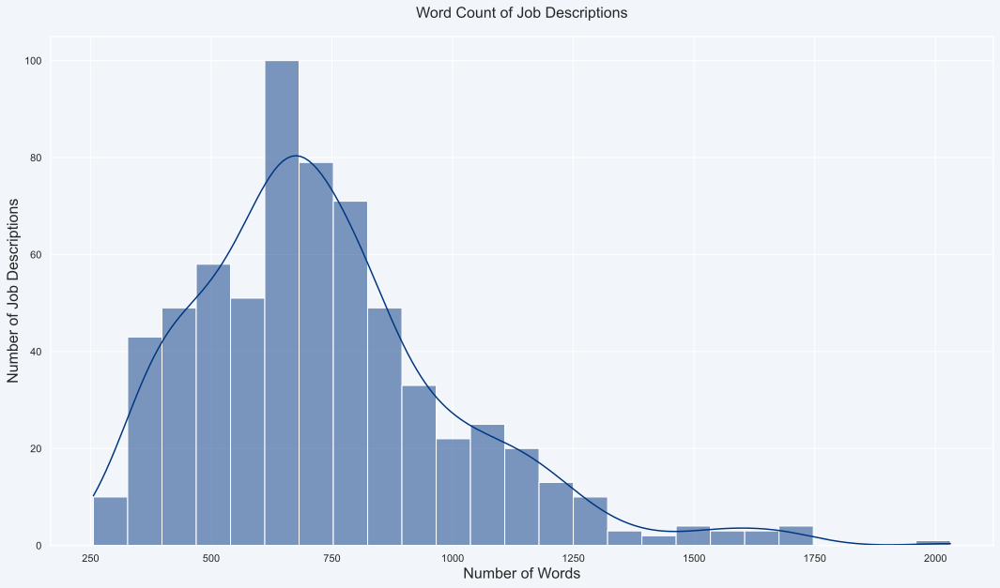

In [13]:
sns.histplot(data=df_stats_raw, x='R_word_count', bins=25, palette=c1, kde=True)

plt.xlabel('Number of Words', fontsize=16)
plt.ylabel('Number of Job Descriptions', fontsize=16)
plt.title('Word Count of Job Descriptions', fontsize=16, pad=20);

In [14]:
print('The average word count for a Job Description is {:1.0f} words'.format(df_stats_raw['R_word_count'].mean()))
print('The longest Job Description is for {}, with a word count of {} words'.format(df_stats_raw.iloc[df_stats_raw['R_word_count'].idxmax()][0],df_stats_raw['R_word_count'].max()))
print('The shortest Job Description is for {}, with a word count of {} words'.format(df_stats_raw.iloc[df_stats_raw['R_word_count'].idxmin()][0],df_stats_raw['R_word_count'].min()))

The average word count for a Job Description is 735 words
The longest Job Description is for Director Legal Trips - Product & Commercial, with a word count of 2031 words
The shortest Job Description is for Office Manager (6 Month Contract), with a word count of 256 words


In [15]:
df_stats_raw[df_stats_raw['R_word_count'] > 1000]

,Job Title,R_word_count,R_char_count,R_word_density,R_punc_count
3,Product Manager - Insurance - Policy Admin,1155,6526,0.176957,116
30,"Commercial Director, Insurance",1280,7779,0.164524,246
51,Team Leader IT support,1277,7630,0.167344,177
52,Head of Human Resources/ HR Leader,1122,6630,0.169205,198
56,Technical Product Manager - Insurance,1122,6320,0.177504,116
...,...,...,...,...,...
578,"Group Product Manager, FinTech - RegTech",1064,5897,0.180400,158
624,Engineering Manager - China Tech,1104,6157,0.179279,128
630,Senior Data Engineer - FinTech,1084,6210,0.174529,173
647,Java Developer,1121,6007,0.186585,113


In [16]:
print('Job Descriptions over 1000 words long: {:.2f}%'.format((df_stats_raw[df_stats_raw['R_word_count'] > 1000].count()[0] / df_stats_raw.shape[0]) * 100))

Job Descriptions over 1000 words long: 15.31%


##### Inference:
> - **50%** of all Job Descriptions fall between roughly **550-850 words**
> - **15%** of Job Descriptions count over 1000 words, mostly for Senior/Director level jobs

### 3.4.3 Character Count

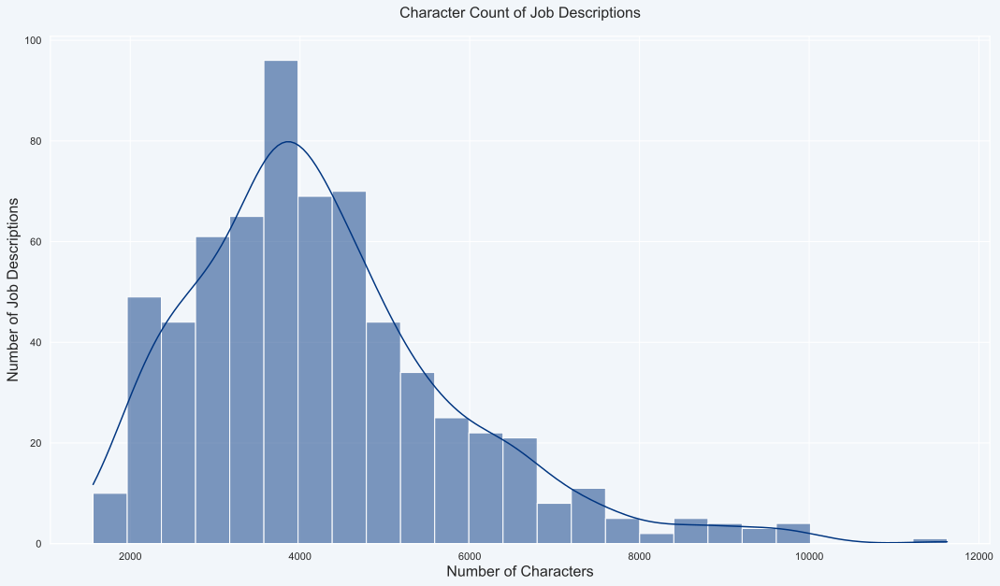

In [17]:
sns.histplot(data=df_stats_raw, x='R_char_count', bins=25, palette=c1, kde=True)

plt.xlabel('Number of Characters', fontsize=16)
plt.ylabel('Number of Job Descriptions', fontsize=16)
plt.title('Character Count of Job Descriptions', fontsize=16, pad=20);

In [18]:
print('The average word count for a Job Description is {:1.0f} words'.format(df_stats_raw['R_char_count'].mean()))
print('The longest Job Description is for {}, with a word count of {} words'.format(df_stats_raw.iloc[df_stats_raw['R_char_count'].idxmax()][0],df_stats_raw['R_char_count'].max()))
print('The shortest Job Description is for {}, with a word count of {} words'.format(df_stats_raw.iloc[df_stats_raw['R_char_count'].idxmin()][0],df_stats_raw['R_char_count'].min()))

The average word count for a Job Description is 4265 words
The longest Job Description is for Director Legal Trips - Product & Commercial, with a word count of 11625 words
The shortest Job Description is for Outbound Executive - Taipei, with a word count of 1562 words


##### Inference:
> - Similar in distribution to the word count graph
> - **50%** of all Job Descriptions fall between roughly **3.200-5.000 characters**

### 3.4.4 Word Density

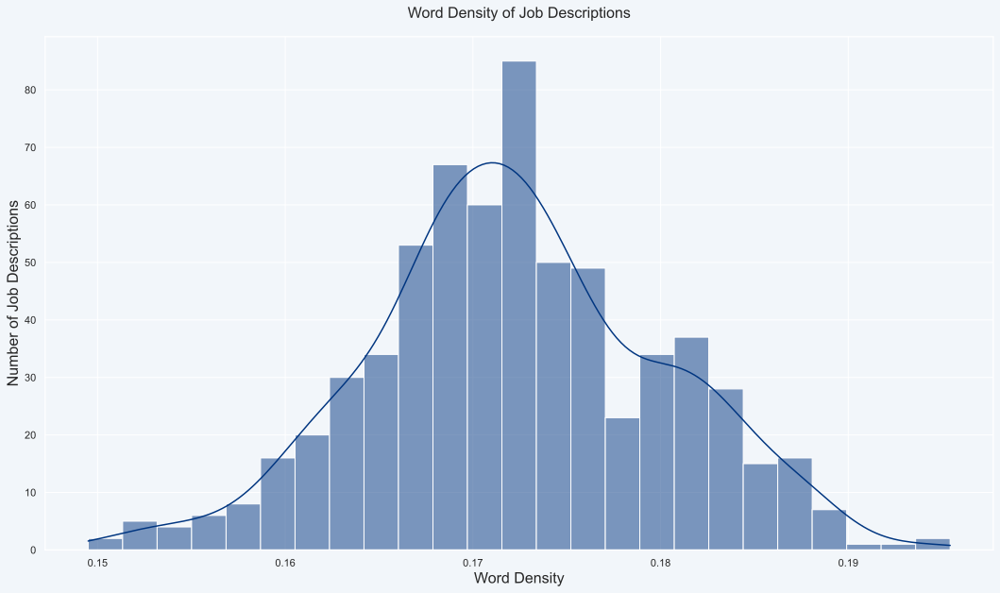

In [19]:
sns.histplot(data=df_stats_raw, x='R_word_density', bins=25, palette=c1, kde=True)

plt.xlabel('Word Density', fontsize=16)
plt.ylabel('Number of Job Descriptions', fontsize=16)
plt.title('Word Density of Job Descriptions', fontsize=16, pad=20);

In [20]:
print('The average word density for a Job Description is {:.3f}'.format(df_stats_raw['R_word_density'].mean()))
print('The Job Description {} has the highest word density: {:.3f}'.format(df_stats_raw.iloc[df_stats_raw['R_word_density'].idxmax()][0],df_stats_raw['R_word_density'].max()))
print('The Job Description {} has the lowest word density: {:.3f}'.format(df_stats_raw.iloc[df_stats_raw['R_word_density'].idxmin()][0],df_stats_raw['R_word_density'].min()))

The average word density for a Job Description is 0.172
The Job Description Senior Front End Developer has the highest word density: 0.195
The Job Description Account Manager - Düsseldorf (m/f/d) has the lowest word density: 0.149


##### Inference:
> - With exceptions of a few outliers the Word Density almost follow a normal distribution centered around **0.172**
> - **50%** of all Job Descriptions have a Word Density between **0.167 and 0.177**

### 3.4.5 Punctuation Count

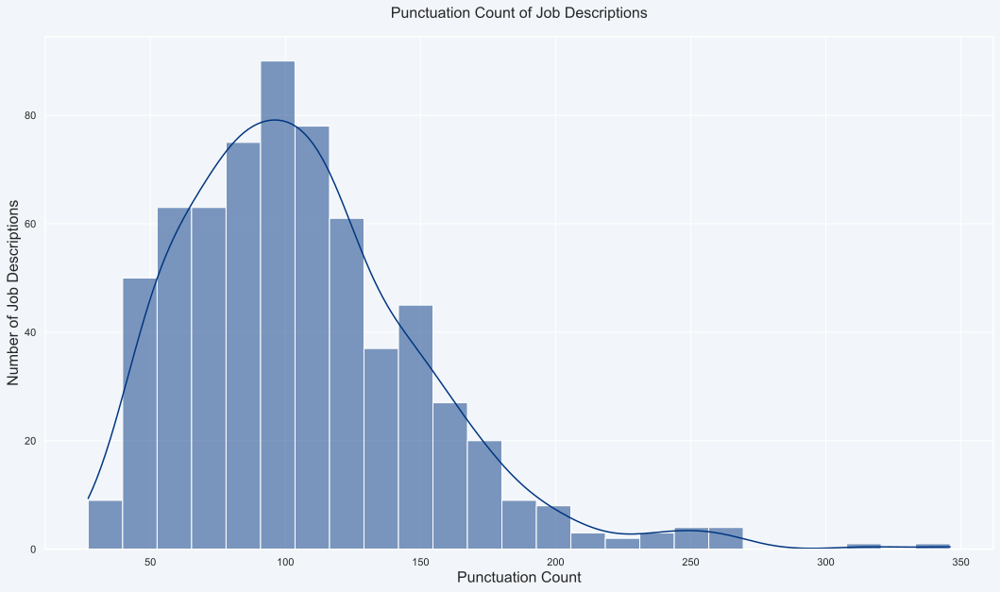

In [21]:
sns.histplot(data=df_stats_raw, x='R_punc_count', bins=25, palette=c1, kde=True)

plt.xlabel('Punctuation Count', fontsize=16)
plt.ylabel('Number of Job Descriptions', fontsize=16)
plt.title('Punctuation Count of Job Descriptions', fontsize=16, pad=20);

In [22]:
print('The average punctuation count for a Job Description is {:.0f} punctuation marks'.format(df_stats_raw['R_punc_count'].mean()))
print('The highest punctuation count is for {}, with a total of {} punctuation marks'.format(df_stats_raw.iloc[df_stats_raw['R_punc_count'].idxmax()][0],df_stats_raw['R_punc_count'].max()))
print('The lowest punctuation count is for {}, with a total of {} punctuation marks'.format(df_stats_raw.iloc[df_stats_raw['R_punc_count'].idxmin()][0],df_stats_raw['R_punc_count'].min()))

The average punctuation count for a Job Description is 106 punctuation marks
The highest punctuation count is for Director Legal Trips - Product & Commercial, with a total of 346 punctuation marks
The lowest punctuation count is for Team Operations Coordinator, with a total of 27 punctuation marks


##### Inference:
> - Generally, Job Descriptions have **106 punctuation marks**
> - Unsurprisingly, there is a strong correlation between amount of punctuation marks and total words used

***

# 4. Text Pre-processing

In order to prepare our text for analysis we need to transform it to be more meaningful. This process will look as follows:

>1. Create lowercase
>2. Tokenization
>3. Removing Stopwords
>4. Normalization 
>5. Removing Punctuation
>6. Character Removal

**1. Create lowercase**
The first step towards a cleaned text is removing obstacles that make comparison more difficult. An easy way to start is by using lowercase for all text to ignore capitalization.

**2. Tokenization**
Tokenisation is a technique for breaking down a piece of text into small units, called tokens. A token may be a word, part of a word or just characters like punctuation.

**3. Removing Stopwords**
Stopwords are frequently used words such as I, a, an, in etc. They do not contribute significantly to the information content of a sentence, so it is advisable to remove them by storing a list of words that we consider stopwords. The library nltk has such lists for 16 different languages that we can refer to.

**4. Normalization**
Text normalization tries to reduce the randomness in text and bring it closer to a predefined standard. This has the effect of reducing the amount of different information and thus improving efficiency. There are two methods for this:

1. Stemming: reducing words to their root or root form (e.g. _Caring_ becomes _Car_)
2. Lemmatization: reducing words to their base word (e.g. _Caring_ becomes _Care_)

The aim of these normalization techniques is to reduce inflectional forms and sometimes derivationally related forms of a word to a common base form. However, the lemmatization algorithms try to reduce the inflected words correctly so that the affiliation of the base word to the language is guaranteed. This aligns better with our project goals, so we'll only use lemmatization as a normalization technique.

Lemmatization uses context to establish which grammatical group a word belongs to (noun, adjective, verb, etc.), called Part-of-speech tagging (POS tagging). Because only one of these tags can be applied when lemmatizing **we start by creating a function that aims to find the correct POS tag before cleaning the text.**

**5. Removing Punctuation**
Punctuation is essentially a set of symbols that offer little in terms of understanding our text as words. Tokenization splits text into words, but it also into punctuation marks. So removing these symbols creates a set of words and parts of words whilst removing the noise.

**6. Character Removal**
After tokenization and the removal of punctuation we can still be left with single/double characters. Most of these will be of no added value to our analysis, with the exception of the programming language R.

In [23]:
def get_pos_func(word):
    '''
    Maps the respective POS tag of a word to the format accepted by the Wordnet lemmatizer
    
    Args:
        word (str): Word to which the function is to be applied
    
    Returns:
        POS tag, readable for the Wordnet lemmatizer
    '''     
    tag = pos_tag([word])[0][1][0].upper()
    tag_dict = {'J': wordnet.ADJ,
                'N': wordnet.NOUN,
                'V': wordnet.VERB,
                'R': wordnet.ADV}

    return tag_dict.get(tag, wordnet.NOUN)

In [24]:
def clean_string_func(text, x):
    '''
    Create cleaned text or list of words
    
    Step 1: Use word_tokenize() to get tokens from lowered string
    Step 2: Use WordNetLemmatizer() to lemmatize the created tokens
            POS tag is determined with the help of function get_wordnet_pos()
    Step 3: Remove stopwords by iterating through tokens
    Step 4: Remove single characters by iterating through tokens
    Step 5: Remove punctuation by iterating through tokens
    Step 6: Join words to create text
    
    Args:
        text (str): String to which the functions are to be applied, string
        x (str): Letter that denotes return type ('w' = words, otherwise text)
    
    Returns:
        List of lemmatize words
        String with lemmatized words
    ''' 
    words = word_tokenize(text.lower()) #Create tokens from text and transform to lowercase
    words = [WordNetLemmatizer().lemmatize(word, get_pos_func(word)) for word in words] #Lemmatize words through appropriate POS from get_pos_func
    words = [wrd for wrd in words if wrd not in stopwords.words('english')] #Remove all words that appear in stopword list
    words = [wrd for wrd in words if len(wrd) > 1 and len(wrd) != 'r'] #Remove single character words that's not programming language R
    words = [wrd for wrd in words if wrd not in string.punctuation] #Remove punctuation
    text = ' '.join(words) #Join words to create text

    if x == 'w':
        return words
    return text

Let's take a look at what a Job Description looks like before and after cleaning:

In [25]:
print('Original text: \n{}'.format(df['Job Description'][0][:500]))

Original text: 
Booking.com It wasn’t so long ago that booking a trip to see the Eiffel Tower, stroll down New York’s iconic Madison Avenue or feel the sand between our toes on Copacabana Beach was simply a matter of a few taps on our smartphone. In fact, that’s what we do at Booking.com. We make it easier for everyone to experience the world. And while that world might feel a little farther away right now, we’re busy preparing for when the world is ready to travel once more. Across our offices worldwide, we co


In [26]:
print('Cleaned text: \n{}'.format(clean_string_func(df['Job Description'][0],'t')[:500]))

Cleaned text: 
booking.com long ago book trip see eiffel tower stroll new york iconic madison avenue feel sand toe copacabana beach simply matter tap smartphone fact booking.com make easy everyone experience world world might feel little farther away right busy prepare world ready travel across office worldwide continue innovate solve complex challenge travel technology plan excite development lie ahead strategic long-term investment believe future travel opening new career opportunity strong impact mission un


***

## 4.1 Baseline revisited

In [27]:
df['Job Description - Cleaned'] = df['Job Description'].apply(lambda x : clean_string_func(x,'t')) #Create new column of cleaned job descriptions

In [28]:
df['C_word_count'] = df['Job Description - Cleaned'].apply(lambda x : len(x.split())) #Splitting strin into words
df['C_char_count'] = df['Job Description - Cleaned'].apply(lambda x : len(x.replace(' ',''))) #Removing spaces and counting characters
df['C_word_density'] = df['C_word_count'] / (df['C_char_count'] + 1) #Devide total words by number of characters
df['C_punc_count'] = df['Job Description - Cleaned'].apply(lambda x : len([a for a in x if a in string.punctuation])) #Count punctuation by comparing to string.punctuation

In [29]:
df.head(3)

,Job Title,Job Description,Location,Team,Country,R_word_count,R_char_count,R_word_density,R_punc_count,Job Description - Cleaned,C_word_count,C_char_count,C_word_density,C_punc_count
0,Junior Endpoints Engineer,"Booking.com It wasn’t so long ago that booking a trip to see the Eiffel Tower, stroll down New York’s iconic Madison Avenue or feel the sand between our toes on Copacabana Beach was simply a matter of a few taps on our smartphone. In fact, that’s what we do at Booking.com. We make it easier for everyone to experience the world. And while that world might feel a little farther away right now, we’re busy preparing for when the world is ready to travel once more. Across our offices worldwide, w...","Manchester, United Kingdom",Engineering,United Kingdom,962,5727,0.167947,161,booking.com long ago book trip see eiffel tower stroll new york iconic madison avenue feel sand toe copacabana beach simply matter tap smartphone fact booking.com make easy everyone experience world world might feel little farther away right busy prepare world ready travel across office worldwide continue innovate solve complex challenge travel technology plan excite development lie ahead strategic long-term investment believe future travel opening new career opportunity strong impact missio...,613,4360,0.140564,23
1,UX Writer - B2B,"At Booking.com, data drives our decisions. Technology is at our core. And innovation is everywhere. But our company is more than datasets, lines of code or A/B tests. We’re the thrill of the first night in a new place. The excitement of the next morning. The friends you make. The journeys you take. The sights you see. And the food you sample. Through our products, partners and people, we make it easier for everyone to experience the world. We’re looking for a UX Copywriter to join our writin...","Amsterdam, Netherlands",Design & User Experience,Netherlands,687,3757,0.182810,77,booking.com data drive decision technology core innovation everywhere company datasets line code a/b test thrill first night new place excitement next morning friend make journey take sight see food sample product partner people make easy everyone experience world look ux copywriter join write team marketing support business travel department close-knit write community make around 15 writer creative copywriter ux writer collaborate across product integrate marketing campaign goal deliver sea...,401,2740,0.146297,13
2,Treasury Risk Specialist,"Booking.com’s global treasury team is looking for a Treasury risk management professional to join our growing team. The Treasury Risk Specialist is responsible for performing financial analysis and operating processes relating to the identification, quantification, management and reporting of credit, counterparty, liquidity and other Treasury risk typologies that attach to Booking’s evolving business models, strategic initiatives and third party relationships. The individual will form an...","Amsterdam, Netherlands",Finance,Netherlands,833,5203,0.160069,106,booking.com global treasury team look treasury risk management professional join grow team treasury risk specialist responsible perform financial analysis operating process relate identification quantification management reporting credit counterparty liquidity treasury risk typology attach book evolve business model strategic initiative third party relationship individual form integral part treasury risk team reporting treasury manager function prefer candidate accustom work fast pace enviro...,562,4099,0.137073,12


In [30]:
df_stats_raw = df[['R_word_count', 'R_char_count', 'R_word_density', 'R_punc_count']].copy() #Create dataframe containing statistical of raw data
df_stats_cleaned = df[['C_word_count', 'C_char_count', 'C_word_density', 'C_punc_count']].copy() #Create dataframe containing statistical of cleaned data

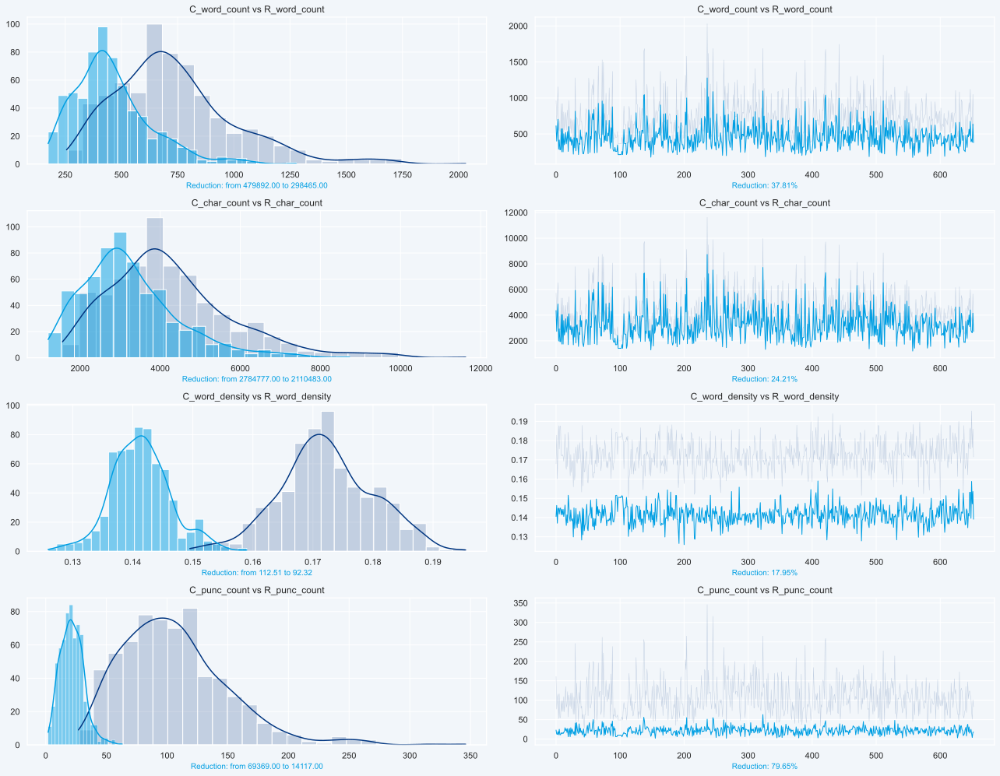

In [31]:
#Subplots
a = 4  #Number of rows
b = 2  #Number of columns
c = 1  #Initialize plot counter

fig = plt.figure(figsize=(18,14))

for i in range(4):
    
    #Bar plots
    plt.subplot(a, b, c)
    g1 = sns.histplot(data=df_stats_raw.iloc[:,i],color=blue_d, kde=True, alpha=.2)
    g2 = sns.histplot(data=df_stats_cleaned.iloc[:,i],color=blue_l, kde=True)
    
    #Bar labels
    g1.set_ylabel(None)
    g2.set_ylabel(None)
    g2.set_xlabel(('Reduction: from {:.2f} to {:.2f}'.format(df_stats_raw.iloc[:,i].sum(),df_stats_cleaned.iloc[:,i].sum())),fontsize=10 ,color=blue_l)
    g2.set_title('{}'.format(df_stats_cleaned.columns[i]+ ' vs ' + df_stats_raw.columns[i]))

    c = c + 1
    
    #Line plots
    plt.subplot(a, b, c)
    g3 = sns.lineplot(data=df_stats_raw, x=df_stats_raw.index, y=df_stats_raw.iloc[:,i], alpha=.2, linewidth=.5)
    g4 = sns.lineplot(data=df_stats_cleaned, x=df_stats_raw.index, y=df_stats_cleaned.iloc[:,i], linewidth=1)
    
    #Line labels
    g3.set_ylabel(None)
    g4.set_ylabel(None)
    g4.set_xlabel(('Reduction: {:.2f}%'.format(abs(((df_stats_cleaned.iloc[:,i].sum()-df_stats_raw.iloc[:,i].sum())/df_stats_raw.iloc[:,i].sum())*100))),fontsize=10,color=blue_l)
    g4.set_title('{}'.format(df_stats_cleaned.columns[i]+ ' vs ' + df_stats_raw.columns[i]))

    c = c + 1
    
plt.tight_layout()

##### Inference:
> - After completing the text pre-processing phase we've successfully reduced noise and created more information dense descriptions
> - For every plot we see the Raw and Cleaned data matches in shape, meaning the reduction is mostly linear (higher word count raw means a higher word count cleaned)
> - Reductions of Word and Character count follow a similar pattern, as they are strongly correlated
> - The highest reduction rate is in Punctuation marks at ~81%, the other ~19% can be explained by contextual punctuation (Booking.com, state-of-the-art, etc.)

***

# 5. EDA - Text

Now that we have our cleaned Job Descriptions, let's look at the overall picture. What kind of things does Booking.com look for in their recruitment? 
We'll add everything together to find the most commonly used words on their career site. Doing this will allow us to gain insight into what words the company uses to describe itself, their values, and what they seek in future employees. To get a more accurate representation of which key words matter most we'll filter out common stopwords.

In [32]:
descriptions = ''.join(d for d in df['Job Description - Cleaned']) #Looping over all cells in Job Description column and joining then together
print ('There are {} words in the combined data-related job descriptions.'.format(len(descriptions))) #Printing results

There are 2408295 words in the combined data-related job descriptions.


In [33]:
word_count = dict(Counter(descriptions.split())) #Creating a dictionary of all words in split description
print('Without ranking the first 10 words look like: {}'.format(dict(itertools.islice(word_count.items(), 10))))

Without ranking the first 10 words look like: {'booking.com': 2874, 'long': 161, 'ago': 171, 'book': 1026, 'trip': 622, 'see': 577, 'eiffel': 136, 'tower': 136, 'stroll': 132, 'new': 1449}


In [34]:
words_popular = {k: v for k, v in sorted(word_count.items(), key=lambda item: item[1], reverse=True)} #Creating dictionary by most popular words by looping over our split descriptions dictionary
print('With ranking the first 10 words look like: {}'.format(dict(itertools.islice(words_popular.items(), 10))))

With ranking the first 10 words look like: {'experience': 4165, 'work': 4081, 'team': 4021, 'business': 3080, 'product': 2980, 'booking.com': 2874, 'data': 1919, 'world': 1912, 'partner': 1801, 'opportunity': 1755}


In [35]:
words_all_jobs = pd.DataFrame.from_dict(words_popular, orient='index',columns=['Count']).reset_index() #(5) Create our cleaned dataframe
words_all_jobs.head(10)

,index,Count
0,experience,4165
1,work,4081
2,team,4021
3,business,3080
4,product,2980
5,booking.com,2874
6,data,1919
7,world,1912
8,partner,1801
9,opportunity,1755


## 5.1 Making Sense of Text

One way to make this intuitively insightful is to use a wordcloud, which displays the most common words in a visual manner. The size of each word corresponds to the frequency of its use.

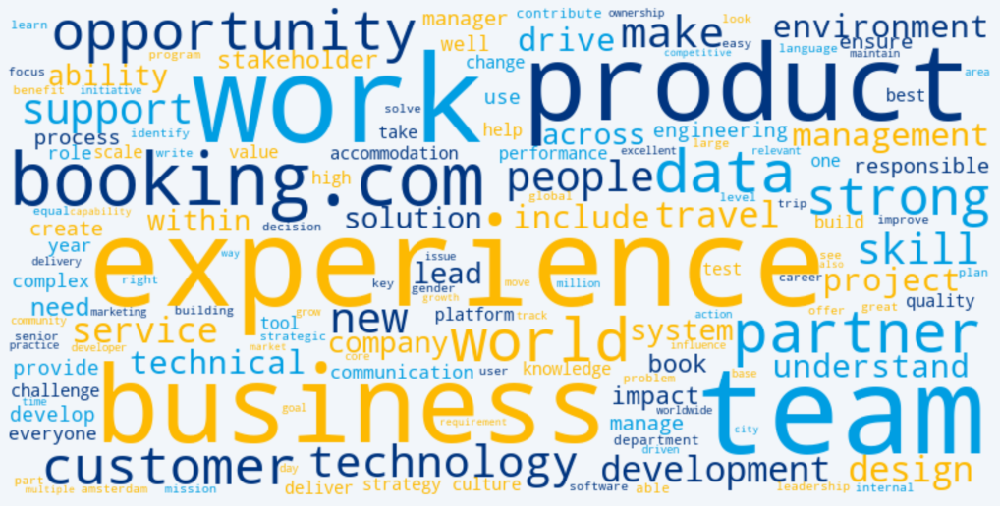

In [36]:
wordcloud = WordCloud(min_font_size=8, max_font_size=100, max_words=500, width=800, height=400,prefer_horizontal=1, background_color='#f2f6fa').generate_from_frequencies(words_popular) #Generate wordcloud class from dictionary

plt.imshow(wordcloud.recolor(colormap=cmap3), interpolation='bilinear')
plt.axis('off')
plt.show();

##### Inference:

> - A few words pop out immediately (Experience, Business, Team, Product, Work), so it's worth paying closer attention to the 'secondary' words as well.
> - **(Machine) Learning**: A general machine learning trend?
    - Treating these as separate words loses out on possible overlap and will require further research
    - Correlation? Machine is often found in combination with Intelligence, Learning often turns up before Models and Code.
    - Overall, 'Machine' hints at strong ML-focus since it's a word rarely used outside of this context (in job positions).
    - Representation - How many jobs are ML-related and how much does this skew our vision of general Booking.com jobs descriptions?
> - **World**: as one of the worlds leading digital travel companies this emphasizes their global presence and state of mind.
> - **Empowerment**: we see a high frequency of words aligning with Booking.com values like: Vision, Development, Identify, Impact, and Ownership.

Wordclouds are great for getting a sense of what's important, but ranking the top 50 most relevant words becomes more difficult. That's why we use a bar chart to accurately rank and communicate our findings.

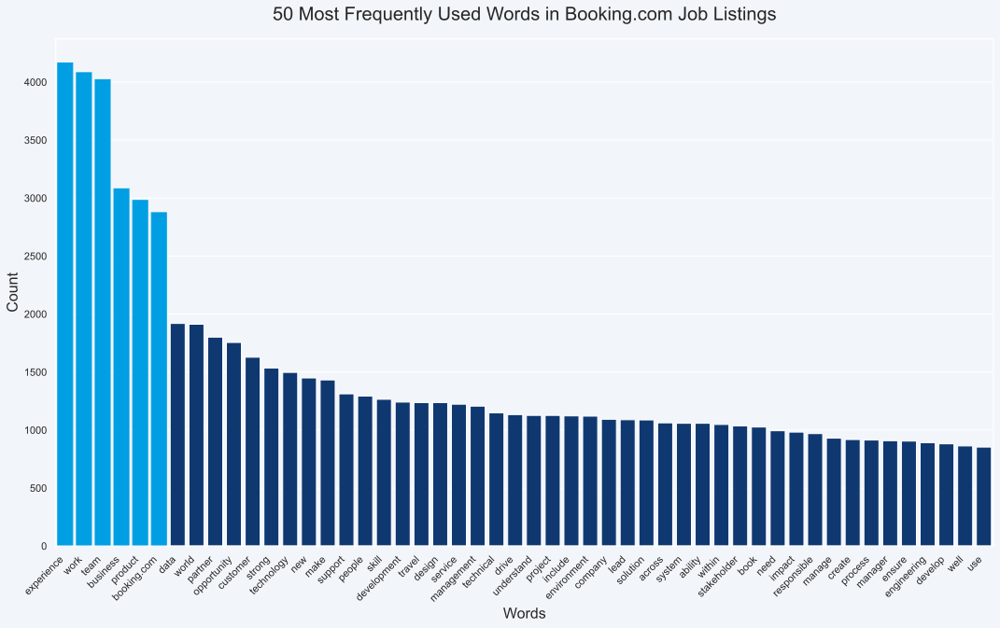

In [37]:
ax = sns.barplot(data=words_all_jobs[:50],x='index',y='Count',palette=c1)

for bar in ax.patches:
    if bar.get_x() < 5:
        bar.set_color(blue_l)

plt.xticks(rotation= 45, ha='right')
plt.xlabel('Words', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.title('50 Most Frequently Used Words in Booking.com Job Listings', fontsize=20, pad=20);

##### **Q:** How big a percentage of all words used is a Top 6 Word?

In [38]:
print('A: {:.2f}%'.format((words_all_jobs['Count'][:6].sum()/words_all_jobs['Count'].sum())*100))

A: 7.12%


Let's calculate the ratio of each of these words per job listing.

In [39]:
words_all_jobs['Ratio_Listings']= words_all_jobs['Count']/df.shape[0] #Creating new column for ratios
words_all_jobs

,index,Count,Ratio_Listings
0,experience,4165,6.378254
1,work,4081,6.249617
2,team,4021,6.157734
3,business,3080,4.716692
4,product,2980,4.563553
...,...,...,...
7138,compliance-ensuring,1,0.001531
7139,business-intelligence,1,0.001531
7140,repetitive,1,0.001531
7141,organisationsenior,1,0.001531


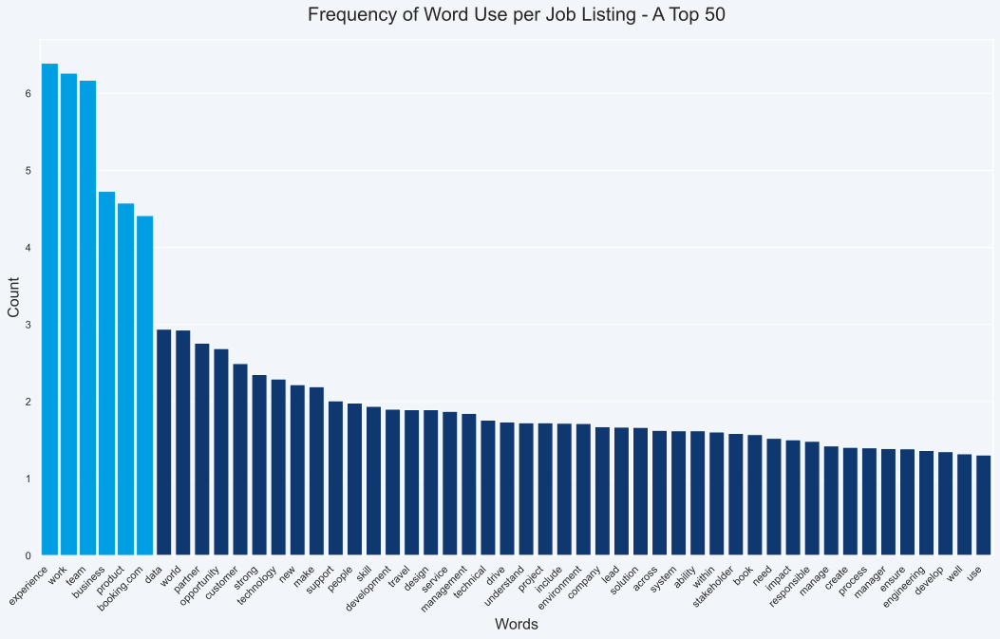

In [40]:
ax = sns.barplot(data=words_all_jobs[:50],x='index',y='Ratio_Listings', palette=c1)

for bar in ax.patches:
    if bar.get_x() < 5:
        bar.set_color(blue_l)    

plt.xticks(rotation = 45, ha= 'right')
plt.xlabel('Words', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.title('Frequency of Word Use per Job Listing - A Top 50', fontsize=20, pad=20);

In [41]:
print(('Top 6 words are at least {:.2f} times more likely to be used in Job Descriptions').format(words_all_jobs['Ratio_Listings'][5]/words_all_jobs['Ratio_Listings'][6]))

Top 6 words are at least 1.50 times more likely to be used in Job Descriptions


##### Inference:

> - The differences between the 6 most used words and the rest is substatial, almost **7,2%** of all words* used is Experience, Work, Team, Business, Product or  Booking.com
> - Top 6 words are at least **1,5 times** more frequenty than other words
> - Top 6 words are all used **over 4 times** per job listing, with the top 3 used of **6 times** (on average)
    
***    
\* _'all words' refers to the cleaned word list, excluding all stopwords. This means the percentages do not represent an absolute, but rather relative number._

***

## 5.2. Job Descriptions

In order to sort Job Descriptions by similarity we can use something else - the Booking.com Career platform has a handy set of teams it uses to sort by.

<p align='center'>
<img src='Images/booking_teams.jpg' style>
</p>

Job positions generally do not fall exclusively in one category, so there will be a lot of overlap. Sorting a Job Title like 'Data Analyst' in the 'Data Science & Analytics' seems intuitive, but where does 'Senior Data Engineer - Data & Machine Learning Platform' fall? In order to categorize, we have to generalize.

##### Bag-of-Words (BoW)

For this approach we'll start with using a Bag-of-Words model, which is a representation of text that describes the occurrence of words within a document. It involves two things:

- A vocabulary of known words.
- A measure of the presence of known words.

It is called a bag-of-words, because any information about the order or structure of words in the document is discarded. The model is only concerned with whether known words occur in the document, not where in the document.

In [42]:
#Creating dictionary of teams and skills from Booking.com career platform
skills_dict = {
    
        'Business Development & Support': [
                                            'Communication', 'Positioning', 'Business Development','Planning',
                                            'Customer Service', 'Reporting', 'Account Management', 'Governance',
                                            'Agile', 'Change Management', 'Compliance', 'Risk Assessment','People Management', 
                                            'Innovation', 'Strategy', 'Service Delivery', 'Networking', 'Technology', 'Integration' 
                                            ],

        'Customer Service': [
                            'Customer Service', 'Training', 'Microsoft Office', 'Sales', 'Communication', 'Languages', 'Investments'
                            ],

        'Data Science & Analytics': [
                                    'Sql', 'Python', 'Data Analysis', 'Tableau', 'Data Science', 'Visualization', 'Insights', 
                                    'Artificial Intelligence', 'Analytics', 'Hadoop', 'Spark', 'Statistics', 'Implementation', 
                                    'Data Management', 'Dashboards', 'Machine Learning', 'Graphite', 'Strategy', 'Forecasting',
                                    'Engineering', 'Metrics', 'Data Modelling'
                                    ],
        
        'Design & User Experience':[
                                    'Testing', 'Agile', 'Design Process', 'Mentoring', 'Six Sigma', 'Product Development', 
                                    'Saas', 'Prototyping', 'Css', 'Html', 'Copywriting', 'User Flows', 'Product Design',
                                    'Adobe', 'Research', 'Invision', 'Ios', 'Android', 'User Experience'
                                    ],
               
        'Engineering': [
                        'Engineering', 'Agile', 'Devops', 'Kubernetes', 'Java', 'Programming', 'Software Development',
                        'Cloud', 'Spring', 'Documentation', 'Soa', 'Technical Leadership', 'Jenkins', 'Ci/cd', 'Aws',
                        'Architecture', 'Machine Learning', 'Infrastructure', 'Product Development', 'Integration',
                        'Mentoring', 'Linux', 
                        ],
               
        'Finance': [
                    'Finance', 'Documentation', 'Risk Management', 'Compliance', 'Financial Analysis', 'Reporting',
                    'Audit', 'Accounting', 'Treasury', 'Pmp', 'Change Management', 'Planning', 'Financial Planning',
                    'Consolidation', 'Variance Analysis', 'Governance', 'Marketing', 'Operations', 'Sap', 'Forecasting' 
                    ],

       'Finance & Legal': [         
                            'Sap', 'Finance', 'Financial Reporting', 'Negotiation', 'Excel', 'Forecasting', 'Reporting',
                            'Risk Management', 'Audit', 'Process Improvement', 'Litigation', 'Internal Audit',
                            'Public Relations', 'Pricing', 'Investigation', 'Analysis', 'Swift', 'Modeling',
                            'Variance Analysis','Cost Control'
                           ],
               
        'IT Services': [
                        'Active Directory', 'Technical Support', 'Troubleshooting', 'Python', 'Configuration', 
                        'Testing', 'Logging', 'Vpn', 'Itil', 'Deployment', 'Maintenance', 'Planning',
                        'Wireless', 'Security', 'Installation', 'Wan', 'Life Cycle', 'Sdlc', 'Technology',
                        'Scrum', 'Documentation', 'Agile', 'Finance', 'Authentication', 'Powershell',
                        'Oauth', 'Api', 'Scripting', 'Git', 'Innovation'
                        ],
          
        'Leadership': [
                        'Engineering','Software Development', 'Strategy', 'Technology', 'Leadership',
                        'Product Management', 'Cloud', 'Infrastructure', 'Implementation', 'Training',
                        'People Management', 'Architecture', 'Designing', 'Devops', 'Agile', 'Api',
                        'E-commerce', 'Software', 'Software Engineering', 'Horizontal'
                        ],      
        
        'Legal & Public Affairs': [
                                    'Litigation', 'Regulatory', 'Compliance', 'Negotiation', 'Drafting',
                                    'Product', 'Governance', 'Corporate Law', 'Due Diligence', 'Fintech',
                                    'E-commerce','Payments' 
                                    ],     
               
               
        'Marketing & Communications': [
                                    'Social Media', 'Marketing', 'E-commerce', 'Media Engagement', 
                                    'Branding', 'Content Management', 'Editing', 'Crm', 'Campaign', 
                                    'Segmentation', 'Positioning', 'Strategy', 'Copywriting', 'Planning',
                                    'Communications', 'Regulatory', 'Compliance', 'Project Management',
                                    'B2b Marketing', 'Marketing Communications', 'Campaigns', 'Translation'
                                    ],
  
        'People': [
                    'Employee Relations', 'Talent Acquisition', 'Performance Management', 'Stakeholder Management', 
                    'Onboarding', 'Talent Management', 'Organizational Development', 'Workday', 'Administration', 
                    'Hr Process', 'Hr Operations', 'Hris', 'Hr', 'Relationship Management', 'Strategy', 'Change Management',
                    'Training', 'Training And Development', 'Metrics', 'Pmp Certification'
                    ],
           
        'Product': [
                    'Product Management', 'Product Design', 'Project Management', 'Product Development', 
                    'Api', 'Product Lifecycle', 'Product Delivery', 'Product Strategy', 'Collaboration',
                    'Agile', 'Strategy', 'Engineering', 'Product Launch', 'Communication', 'Metrics', 'Sql',
                    'Ux Design', 'Testing', 'Payments', 'Ci/Cd', 'Pipelines', 'Grafana'
                    ],
        
        'Security & Infrastructure': [
                                    'Linux', 'Networking', 'Security', 'Ansible', 'Cloud Computing', 'Automation', 
                                    'Infrastructure', 'Architecture', 'Docker', 'Distributed Systems', 'Mysql', 
                                    'Terraform', 'Openstack', 'Perl', 'Engineering', 'Programming', 'Troubleshooting',
                                    'Software Development', 'Monitoring', 'Python', 'Jenkins'
                                    ]
        }

Let's first find out which keywords pop up in the Job Descriptions per Team

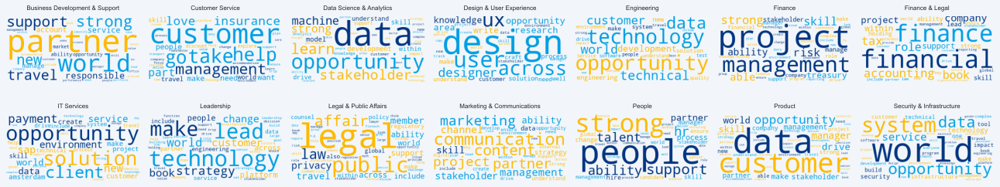

In [43]:
fig = plt.figure(figsize=(18,4))
count = 1
for key in skills_dict.keys():
    descriptions = ''.join(d for d in df[df['Team']==key]['Job Description - Cleaned'])
    word_count = dict(Counter(descriptions.split())) #Creating a dictionary of all words in split description
    words_popular = {k: v for k, v in sorted(word_count.items(), key=lambda item: item[1], reverse=True)} #Creating dictionary by most popular words by looping over our split descriptions dictionary
    words_popular = {k: v for k, v in words_popular.items() if k not in {'experience', 'work', 'team', 'business', 'product', 'booking.com'}} #Removing top 6 words

    wordcloud = WordCloud(min_font_size=8, max_font_size=100, max_words=500,prefer_horizontal=1, background_color='#f2f6fa').generate_from_frequencies(words_popular) #Generate wordcloud class from dictionary

    ax = plt.subplot(2, 7, count)

    plt.imshow(wordcloud.recolor(colormap=cmap3), interpolation='bilinear')
    plt.title(key, fontsize=8, pad=8)

    ax.imshow(wordcloud)
    ax.axis('off')

    count = count + 1
    
plt.tight_layout(pad=.8)

Let's clean up our dictionary so that it matches our Job Descriptions.

In [44]:
def clean_dict(dic,text, x):
     
    words = dic[text] #Set skills to matching skill-set (values) of dictionary
    words = [x.lower() for x in words] #Lower words to match Job Description
    words = ' '.join(words) #Join to create list
    words = list(set(str(words).split())) #Create split list of words and remove duplicates
    words = [WordNetLemmatizer().lemmatize(word, get_pos_func(word)) for word in words] #Lemmatize words through appropriate POS from get_pos_func
    words = [wrd for wrd in words if wrd not in stopwords.words('english')] #Remove all words that appear in stopword list
    words = [wrd for wrd in words if len(wrd) > 1 and len(wrd) != 'r'] #Remove single character words that's not programming language R
    words = [wrd for wrd in words if wrd not in string.punctuation] #Remove punctuation
    words = list(dict.fromkeys(words))
    #text = ''.join(words) #Join words to create text

    if x == 'w':
        return words
    return text

In [45]:
skills_dict_clean = {key:(clean_dict(skills_dict,key,'w')) for (key, value) in skills_dict.items()}

In [46]:
df_team = df[['Job Title','Job Description - Cleaned']].copy() #Creating new dataframe with only Job Title and Description

In [47]:
def skill_finder(df, dic, team):
    df[team] = 0 #Settings initial value to 0
    skills = dic[team] #Set skills to matching skill-set (values) of dictionary   

    for i in range(df.shape[0]): #Looping through all rows of df
        description = df['Job Description - Cleaned'][i] #Getting Cleaned Job Description
        for j in range(len(skills)): #Looping through dictionary of skills
            if skills[j] in description: #Comparing list of skills to words in Job Descriptions
                df[team][i] += 1 #Adding 1 to all matches

    return df

In [48]:
#Iteraring through skills dictionary and calling skill_finder() on each key
for key,value in skills_dict_clean.items():
    skill_finder(df_team,skills_dict_clean,key)

df_team.head(10)

,Job Title,Job Description - Cleaned,Business Development & Support,Customer Service,Data Science & Analytics,Design & User Experience,Engineering,Finance,Finance & Legal,IT Services,Leadership,Legal & Public Affairs,Marketing & Communications,People,Product,Security & Infrastructure
0,Junior Endpoints Engineer,booking.com long ago book trip see eiffel tower stroll new york iconic madison avenue feel sand toe copacabana beach simply matter tap smartphone fact booking.com make easy everyone experience world world might feel little farther away right busy prepare world ready travel across office worldwide continue innovate solve complex challenge travel technology plan excite development lie ahead strategic long-term investment believe future travel opening new career opportunity strong impact missio...,9,6,7,9,11,4,6,18,10,2,2,11,9,10
1,UX Writer - B2B,booking.com data drive decision technology core innovation everywhere company datasets line code a/b test thrill first night new place excitement next morning friend make journey take sight see food sample product partner people make easy everyone experience world look ux copywriter join write team marketing support business travel department close-knit write community make around 15 writer creative copywriter ux writer collaborate across product integrate marketing campaign goal deliver sea...,9,3,5,10,1,3,3,7,6,1,10,6,9,0
2,Treasury Risk Specialist,booking.com global treasury team look treasury risk management professional join grow team treasury risk specialist responsible perform financial analysis operating process relate identification quantification management reporting credit counterparty liquidity treasury risk typology attach book evolve business model strategic initiative third party relationship individual form integral part treasury risk team reporting treasury manager function prefer candidate accustom work fast pace enviro...,9,3,9,6,2,10,14,7,6,4,6,7,7,4
3,Product Manager - Insurance - Policy Admin,company long ago book trip see eiffel tower stroll new york iconic madison avenue feel sand toe copacabana beach simply matter tap smartphone fact booking.com make easy everyone experience world world might feel little farther away right busy prepare world ready travel across office worldwide continue innovate solve complex challenge travel technology plan excite development lie ahead strategic long-term investment believe future travel opening new career opportunity strong impact mission un...,15,6,7,10,8,8,8,11,9,3,3,10,12,4
4,Account Executive - Manchester,account executive bristol full time position base amaze manchester office company long ago book trip see eiffel tower stroll new york iconic madison avenue feel sand toe copacabana beach simply matter tap smartphone fact booking.com make easy everyone experience world world might feel little farther away right busy prepare world ready travel across office worldwide continue innovate solve complex challenge travel technology plan excite development lie ahead strategic long-term investment bel...,9,6,2,5,3,1,4,5,4,1,3,5,4,1
5,Senior Android Developer - Accommodations,job booking.com data drive decision technology core innovation everywhere company datasets line code a/b test thrill first night new place excitement next morning friend make journey take sight see food sample product partner people empower everyone experience world accommodation technology team responsible design delivery reliability service use million customer partner web via mobile extensive apis 28 million place stay list platform work hard develop product make easy traveller find best ...,10,4,3,10,10,1,3,9,11,3,3,6,10,6
6,Account Executive - Nairobi (Amharic Speaker),company long ago book trip see eiffel tower stroll new york iconic madison avenue feel sand toe copacabana beach simply matter tap smartphone fact booking.com make easy everyone experience world world might feel little farther away right busy prepare world ready travel across office w

We've created a dataframe that scores Job Descriptions based on their resemblance to the Booking.com Teams and Skills dictionary. The next step is to explore it as a means of categorization.

In [49]:
df_team_num = df_team.drop(columns=['Job Title', 'Job Description - Cleaned']).copy() #Creating a copy with only numeric values

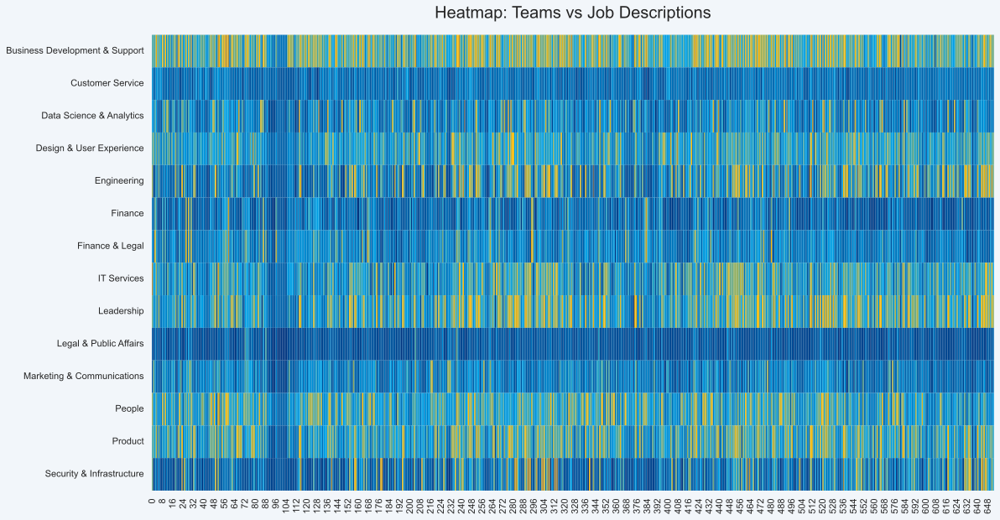

In [50]:
cmap = mpl.colors.LinearSegmentedColormap.from_list('my color', c4, N=256) #Creating cmap from Booking.com colors
g = sns.heatmap(df_team_num.T,cbar=False, cmap=cmap)
g.set_title('Heatmap: Teams vs Job Descriptions',fontsize=20, pad=20);

How can we explain the dip of skill score between rougly Job Title 90-100?

In [51]:
df_team.iloc[93:110]['Job Title']

93             Customer Sales Advisor - English Speaker
94              Customer Sales Advisor - German Speaker
95             Customer Sales Advisor - Italian Speaker
96              CS Internal Control Quality Team Leader
97                 Customer Relations Advisor (Turkish)
98                  Customer Relations Advisor (Korean)
99                  Customer Relations Advisor (French)
100                Customer Relations Advisor (English)
101                  Customer Relations Advisor (Dutch)
102                 Customer Relations Advisor (Danish)
103            Customer Sales Advisor - Spanish Speaker
104                  Customer Relations Advisor (Czech)
105     Customer Relations Advisor - Insurance (French)
106        Program Manager - Digital Partner Experience
107    Customer Relations Advisor - Insurance (Swedish)
108     Customer Relations Advisor - Insurance (German)
109      Customer Relations Advisor - Insurance (Dutch)
Name: Job Title, dtype: object

It turns out these are all Customer Relations Advisors where the Job Descriptions is generally a copy of the text below, adjusted by language. These Job Descriptions are some of the shortest (at 250 words) and mean skill score of 3. Surprisingly, they don't score all that well on Customer Service - the team they've been categorized into.

In [52]:
df['Job Description'][94]

'Customer Sales Advisor – German Speaker Booking.com Transport Business Unit We’re on a mission to make it easier for everyone to experience the world. Whether they’re heading straight from A to B or enjoying the freedom to go wherever their journey takes them. We’re part of the worldwide Booking.com family. We speak 42 languages, our staff (in Manchester) come from all over the world, just like our customers. What brings us together is our love of adventure. It’s easy to be enthusiastic about a job that enriches so many lives on a daily basis, and our workplace reflects our diversity and global focus. If you’re like us, you’ll love to help people. You’ll love travel and new life experiences too. Put these drives together and you get an international team who’ll take problems and turn them into solutions, increasing customer satisfaction and helping to grow our international business. What you’ll be doing: Helping customers to book their worldwide car hire, giving a consultative, tailo

In [53]:
for col in df_team_num.columns:
    val = df_team_num[col].sum()

    print('{} - {}'.format(col,val))

Business Development & Support - 6334
Customer Service - 2315
Data Science & Analytics - 3486
Design & User Experience - 4691
Engineering - 4166
Finance - 2229
Finance & Legal - 3248
IT Services - 4622
Leadership - 5263
Legal & Public Affairs - 1279
Marketing & Communications - 2955
People - 5080
Product - 5097
Security & Infrastructure - 3152


##### Inference:

> - Skill scores differ a lot per team - from **1279** (Legal & Public Affairs) to **6334** (Business Development & Support)
> - **Business & Development, Leadership, Product and People** score best, meaning most commonality between skill dictionary and Job Description
> - **Customer Relations** jobs score low on our skill dictionary
> - Variety in Skill score per Team is, in part, a consequence of representation (i.e. there being many more jobs in one category over another)
> - Variety in Skills score can also be explained by key words offered in the dictionary (i.e. more general words have a higher frequency)

In order to get more insight into how individual Job Descriptions rate we plot them individually. Radar plots can help us understand how each job listing scores. As means of categorization we take start with the obvious approach; which is to sort a job into the category it scores highest.

In [54]:
def treshold_finder(df, treshold):
    '''
    Determine treshhold for visualizing radarplots that balances skills vs legibility
    
    Args:
        df (DataFrame): Data to plot
        treshold (int): Height of Y-axis
    '''
    print('With a Treshhold of {} we drop the following data:\n'.format(treshold))

    for col in df.columns:
        val = df[col].value_counts().sort_index()
        print('{} - {:.2f}% of data'.format(col,((val[val.index > treshold].values.sum())/val[val.index < treshold+1].values.sum())*100))

In [55]:
treshold_finder(df_team_num,15)

With a Treshhold of 15 we drop the following data:

Business Development & Support - 3.32% of data
Customer Service - 0.00% of data
Data Science & Analytics - 2.19% of data
Design & User Experience - 0.31% of data
Engineering - 2.67% of data
Finance - 0.31% of data
Finance & Legal - 0.31% of data
IT Services - 0.31% of data
Leadership - 0.93% of data
Legal & Public Affairs - 0.00% of data
Marketing & Communications - 0.00% of data
People - 0.31% of data
Product - 0.15% of data
Security & Infrastructure - 3.82% of data


In [56]:
def radar_plot(f1,f2,df,dic,row,col,treshold,v):
    '''
    Create radar plots from Dataframe
    
    Step 1: Create labels from given dictionary
    Step 2: Define angles and create closes circle
    Step 3: Define colors
    Step 4: Loop through subplots by given row and column
    Step 5: Plot Radar plots
    
    Args:
        f1 (float): Figure width 
        f2 (float): Figure height 
        df (DataFrame): Data to plot
        dic (dict): Labels/categories
        row (int): Number of rows to plot
        col (int): Number of columns to plot
        treshold (int): Y-limit of bars
        v (str): Verbose option by using 'v'
    
    Returns:
        Radar plots
    '''
    fig = plt.figure(figsize=(f1,f2))
    
    labels = np.array(list(dic.keys())) #Creating labels from team names
    
    angles = np.linspace(0, 2*np.pi, len(labels), endpoint=False) #Defining angles
    angles = np.concatenate((angles,[angles[0]])) #Concatenating angles to create full loop
    
    count = 1
    dimensions = row*col
    
    #Colors
    cmap = mpl.colors.LinearSegmentedColormap.from_list('my color', c2, N=treshold) #Creating cmap from color list - change to c2 for Booking.com colors
    norm = mpl.colors.Normalize(vmin=0, vmax=treshold) #Create normalization

    for i in range(dimensions):

        #Bar plots
        ax = plt.subplot(row, col, count, projection='polar')

        stats = df.loc[i,labels].values.astype(np.int64) #Creating list of stats from team column
        stats = np.concatenate((stats,[stats[0]])) #Concatenating stats to create full loop
        colors = cmap(norm(stats)) #Normalize colors to match data to cmap
                
        #Plot
        ax.set_theta_offset(np.pi / 2) #Rotating plot
        ax.set_ylim(0, treshold) #Setting y limits
    

        if v == 'v':
            ax.bar(angles, stats, color=colors, width=.45, zorder=0)

            ax.xaxis.grid(True) #Turning on x axis
            ax.yaxis.grid(True) #Turning on x axis
            ax.yaxis.set_visible(True)
            ax.set_title(df.iloc[i][0], fontsize=18,pad=10) #Setting title
            ax.set_xticks(angles[:-1])
            ax.set_xticklabels(labels, size=12)
            ax.tick_params(axis='x', pad=60, zorder=1)
            ax.vlines((angles), 0, treshold, color=grey, ls=(0, (4, 4)), zorder=50)
                
        else: 
            ax.bar(angles, stats, color='#f2f6fa', width=.45, zorder=0)
            ax.xaxis.grid(False) #Turning off x axis
            ax.yaxis.grid(False) #Turning off x axis
            ax.yaxis.set_visible(False)
            ax.xaxis.set_visible(False)
            ax.set_facecolor(color = c15[stats.argmax()])
    
        count = count + 1
    
    return plt.tight_layout(pad=.8)

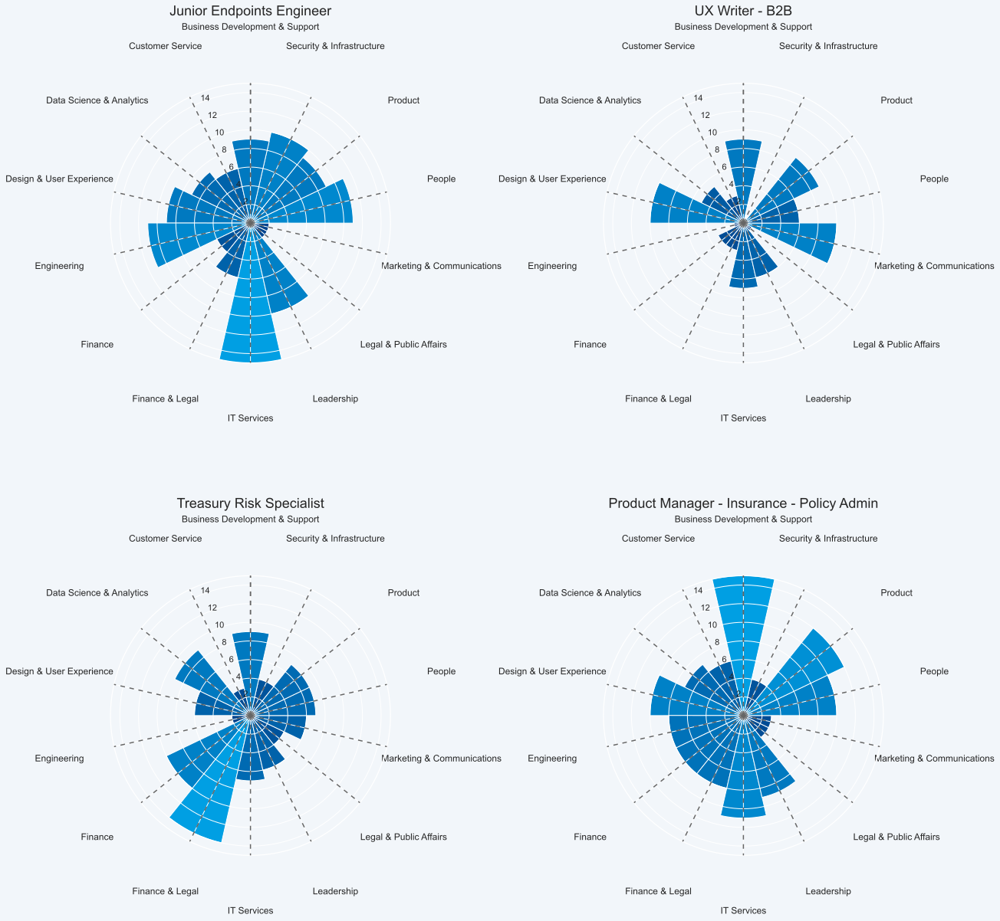

In [57]:
radar_plot(18,18,df_team,skills_dict_clean,2,2,15,'v')

We can see that Job Descriptions score in multiple Team categories. Some are generalists and other highly specialized, which is reflected in the plot. In order to use it as a means for categorization, we color code each Team and plot the radar plots for all jobs.

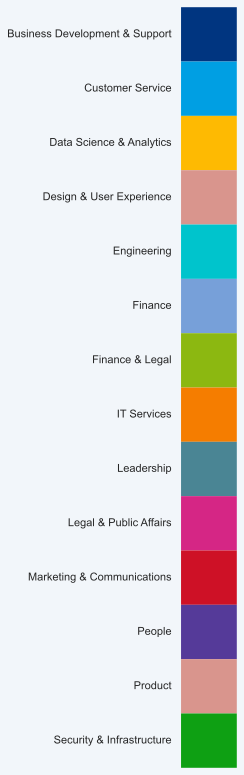

In [58]:
#Creating simple Color bar to serve a legend for radar plots
df_color = df_team_num.head(1).copy()
df_color.iloc[0] = np.arange(14)

fig = plt.figure(figsize=(1,14))
cmap = mpl.colors.LinearSegmentedColormap.from_list('my color', c15, N=14) #Creating cmap from Booking.com colors
g = sns.heatmap(df_color.T,cbar=False, xticklabels=False, cmap=c15[:-1])

In [59]:
radar_plot(18,18,df_team,skills_dict_clean,26,25,15,'x')

##### Inference:

> - The colorful confetti suggests that using the provided skill sets as indicators for indicating Teams offers a view of overall jobs being well balanced, with an overhand of jobs within the Business Development & Support team.
> - Legal & Public Affairs and Customer Support do not show up once on this plot, which could be because it too much overlap in skills with other teams
> - Jobs in Engineering, Data Science & Analytics and Security & Infrastructures seem most specialized as suggesting by bar heights in respective skill


***
##### Comments:
> - The chosen method of using argmax() to pick category return only one value. This creates bias as plots with equal scores in two categories will default to the first occurance
> - The dictionary method is biased towards jobs requiring hard skills, as it offers only a limited set of skills which doesn't cover many softer skills
> - For graphic reasons ~0.5% of data has been omitted (3 jobs), these cases will be included in further analysis


## 5.3 A closer look at top jobs

##### Which jobs require the highest overall skills?

In [60]:
df_team['Score'] = df_team_num.sum(axis=1)
df_score = df_team.sort_values(by='Score',ascending=False).copy()
df_score[['Job Title', 'Score']].head(10)

,Job Title,Score
238,Senior Full Stack Developer,148
511,Mobile Engineering Manager - Rides,147
520,Manager of Data Engineering - Partner Services Business Insights,139
289,Senior Data Engineer- Accommodation Data Platform,139
251,Senior Data Engineer (SQL),137
51,Team Leader IT support,136
283,Solutions Architect - Insurance,133
347,Data Engineer,132
325,Director of Product DMLP,129
246,Senior Director Financial Systems,129


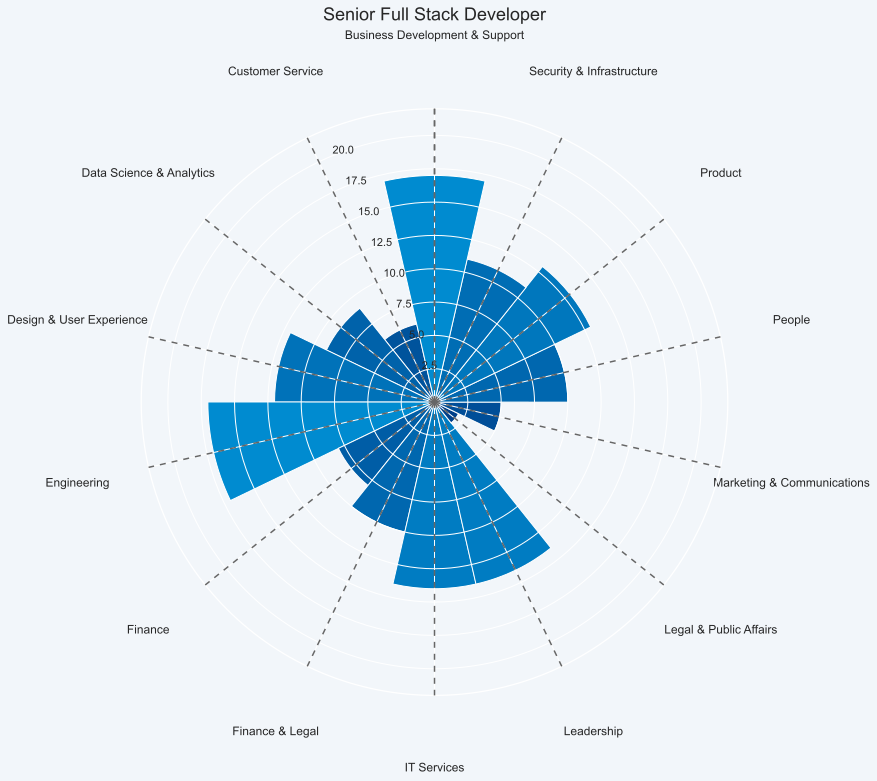

In [61]:
df_score.reset_index(inplace=True)
df_score.drop(columns='index', inplace=True)
radar_plot(12,12,df_score,skills_dict,1,1,22,'v')

##### Which jobs require the most general skills?

In [62]:
df_team['Score_median'] = df_team_num.median(axis=1)
df_median = df_team.sort_values(by='Score_median',ascending=False).copy()
df_median[['Job Title', 'Score_median']].head(10)

,Job Title,Score_median
289,Senior Data Engineer- Accommodation Data Platform,11.5
347,Data Engineer,11.0
203,Machine Learning Engineering Manager - Ranking,10.5
238,Senior Full Stack Developer,10.5
283,Solutions Architect - Insurance,10.0
251,Senior Data Engineer (SQL),10.0
520,Manager of Data Engineering - Partner Services Business Insights,10.0
511,Mobile Engineering Manager - Rides,10.0
630,Senior Data Engineer - FinTech,10.0
363,Engineering Manager - Partnerships,9.5


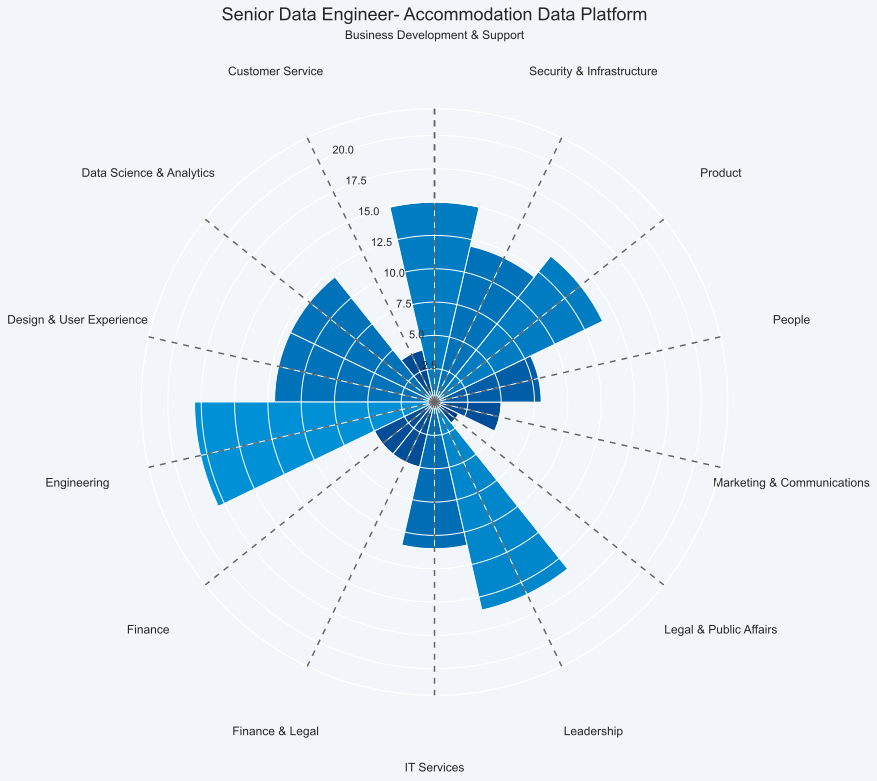

In [63]:
df_median.reset_index(inplace=True)
df_median.drop(columns='index', inplace=True)
radar_plot(12,12,df_median,skills_dict,1,1,22,'v')

##### Which jobs require the most specific skills?

In [64]:
df_team['Score_max'] = df_team_num.max(axis=1)
df_max = df_team.sort_values(by='Score_max',ascending=False).head(10)
df_max[['Job Title', 'Score_max']].head(10)

,Job Title,Score_max
342,Engineering Manager - Apps,21
242,Data Scientist Insights - App Marketing,21
547,Engineering Manager - Trips,20
492,Data Scientist Insights - Digital Media,20
482,Engineering Manager - Insurance - Front-End,20
129,Booking for Business Data Analyst,19
313,Senior Site Reliability Engineer Observability -Technical Operations,19
308,Senior Site Reliability Engineer - Application Data Services (Core Platforms),19
307,Site Reliability Engineer - Application Data Services (Core Platforms),19
314,Site Reliability Engineer Products Performance & Reliability - Core Platform,19


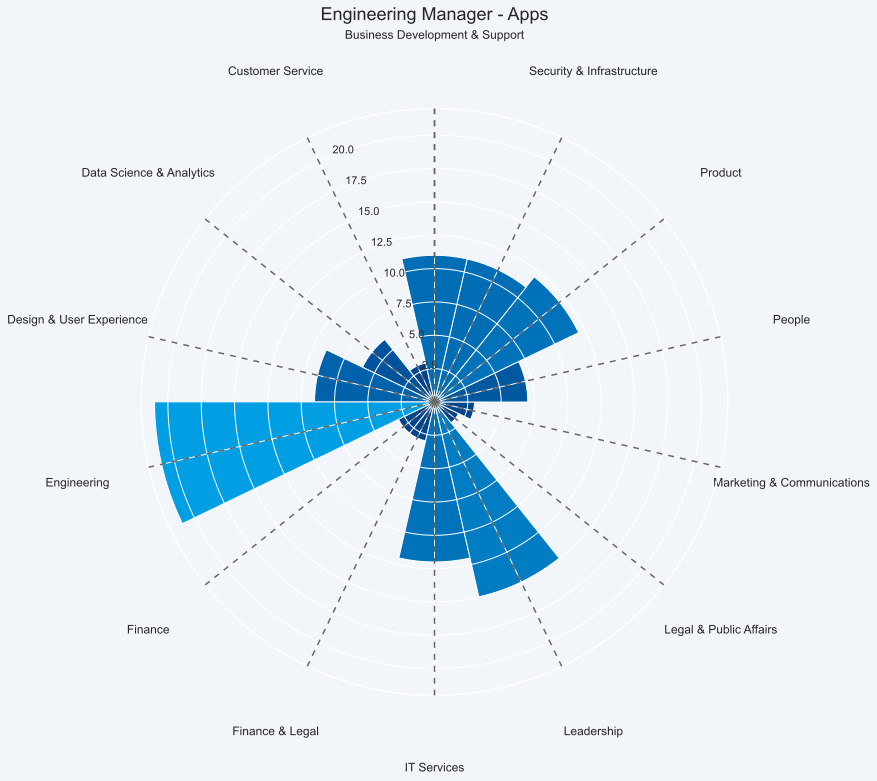

In [65]:
df_max.reset_index(inplace=True)
df_max.drop(columns='index', inplace=True)
radar_plot(12,12,df_max,skills_dict,1,1,22,'v')

# 6. Predicted value vs True value comparison

In order to see how accurately we've categorized our Job Descriptions, let's compare it to our original dataframe.

In [66]:
df_pred = df_team_num.copy()
df_pred['Team_pred_max_score'] = df_team_num.idxmax(axis=1)
df_pred[['Team','Job Title']] = df[['Team','Job Title']]
df_pred = df_pred[['Job Title','Team','Team_pred_max_score']]
df_pred['Match']=df_pred.apply(lambda x: 1 if x['Team'] == x['Team_pred_max_score'] else 0,axis=1) #Adding a Match column for every correct guess
df_pred

,Job Title,Team,Team_pred_max_score,Match
0,Junior Endpoints Engineer,Engineering,IT Services,0
1,UX Writer - B2B,Design & User Experience,Design & User Experience,1
2,Treasury Risk Specialist,Finance,Finance & Legal,0
3,Product Manager - Insurance - Policy Admin,Product,Business Development & Support,0
4,Account Executive - Manchester,Business Development & Support,Business Development & Support,1
...,...,...,...,...
648,Senior Software Developer - Horizontal Business Services - Java / Cassandra,Engineering,Design & User Experience,0
649,Senior Front End Developer,Engineering,Engineering,1
650,Technical Programme Manager,Engineering,Business Development & Support,0
651,Senior Java Developer,Engineering,Engineering,1


In [67]:
print('Using the highest skills rating as means of classifying teams yields us a correct predcition rate of {:.2f}%'.format((df_pred['Match'].sum() / df_pred.shape[0])*100))

Using the highest skills rating as means of classifying teams yields us a correct predcition rate of 45.18%


In [68]:
df_pred_correct = df_pred[df_pred['Match'] == 1].groupby(by='Team')['Team'].count()
correct = (df_pred_correct / df_pred.shape[0]) * 100
print('{}\n\nTotal correct predictions: {:.2f}%'.format(correct,correct.sum()))

Team
Business Development & Support    14.088821
Data Science & Analytics           4.287902
Design & User Experience           4.747320
Engineering                        8.422665
Finance & Legal                    0.459418
IT Services                        0.306279
Leadership                         0.612557
Marketing & Communications         1.684533
People                             6.278714
Product                            1.225115
Security & Infrastructure          3.062787
Name: Team, dtype: float64

Total correct predictions: 45.18%


In [69]:
df_pred_wrong = df_pred[df_pred['Match'] == 0].groupby(by='Team')['Team'].count()
wrong = (df_pred_wrong / df_pred.shape[0]) * 100
print('{}\n\nTotal wrong prediction: {:.2f}%'.format(wrong,wrong.sum()))

Team
Business Development & Support     2.603369
Customer Service                   3.828484
Data Science & Analytics           0.918836
Design & User Experience           1.531394
Engineering                       21.439510
Finance                            1.531394
Finance & Legal                    1.837672
IT Services                        0.918836
Leadership                         3.062787
Legal & Public Affairs             0.612557
Marketing & Communications         3.828484
People                             4.134763
Product                            4.134763
Security & Infrastructure          4.441041
Name: Team, dtype: float64

Total wrong prediction: 54.82%


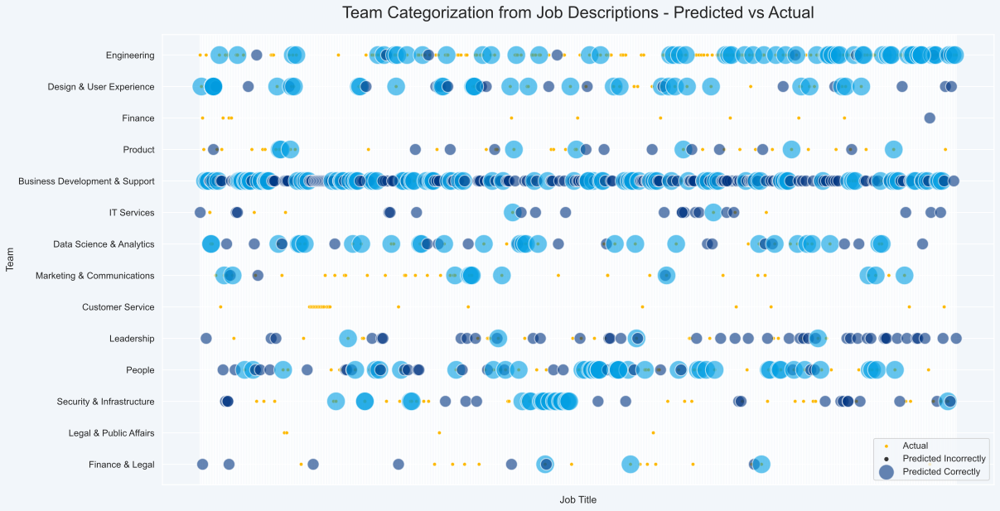

In [70]:
ax = sns.scatterplot(data=df_pred,x='Job Title',y='Team',color=yellow,alpha=1, size=300)
sns.scatterplot(data=df_pred,x='Job Title',y='Team_pred_max_score',color=yellow,alpha=.6,hue='Match',size='Match',sizes=[500,200],size_order=[1,0])

plt.title('Team Categorization from Job Descriptions - Predicted vs Actual', fontsize=20, pad=20);
plt.legend(['Actual', 'Predicted Incorrectly', 'Predicted Correctly']);
ax.set_xticklabels([]);

##### Inference:

> - Using Bag-of-Words (BoW) methodology gains us a meager **45%** correct prediction rate.
> - Job Descriptions with fewer words, fewer keywords and are generally focused towards more general skills can suffer when only looking at word occurrences.
> - Engineering jobs were hardest to predict correctly (**21%**), Business Development & Support jobs were easiest to predict (**14%**)
***
##### Comments:
> - For a more serious effort to predict Team by Job Descriptions, see ML section up ahead.

***

# 7. Data Jobs

Let's take a closer look at Data related Jobs.

In [71]:
df_data = df[df['Team'] == 'Data Science & Analytics'].copy()
df_data = df_data[['Job Title', 'Job Description','Job Description - Cleaned', 'Country']]
df_data.reset_index(inplace=True,drop=True)
df_data.head()

,Job Title,Job Description,Job Description - Cleaned,Country
0,Senior Data Scientist - Accommodations,"Booking.com is looking for data savvy professionals to join our team of data scientists. You will be working with stakeholders throughout the company to generate understanding, strategy and suggest actions based on data. If you consider yourself to be that unique hybrid of data hacker, business analyst, communicator and mentor that maintains a strong customer focus and values pragmatism over perfection, then we’d like to hear from you. There are several data science teams within Booking.com ...",booking.com look data savvy professional join team data scientist work stakeholder throughout company generate understand strategy suggest action base data consider unique hybrid data hacker business analyst communicator mentor maintains strong customer focus value pragmatism perfection like hear several data science team within booking.com consist 3-8 people team scope within business data scientist focus front end website content page demand product customer satisfaction loyalty every team...,Netherlands
1,Senior Data Scientist - Accommodations,"Booking.com is looking for data savvy professionals to join our team of data scientists. You will be working with stakeholders throughout the company to generate understanding, strategy and suggest actions based on data. If you consider yourself to be that unique hybrid of data hacker, business analyst, communicator and mentor that maintains a strong customer focus and values pragmatism over perfection, then we’d like to hear from you. There are several data science teams within Booking.com ...",booking.com look data savvy professional join team data scientist work stakeholder throughout company generate understand strategy suggest action base data consider unique hybrid data hacker business analyst communicator mentor maintains strong customer focus value pragmatism perfection like hear several data science team within booking.com consist 3-8 people team scope within business data scientist focus front end website content page demand product customer satisfaction loyalty every team...,Netherlands
2,Senior Data Analyst - Accommodations,"At Booking.com, data drives our decisions. Technology is at our core. And innovation is everywhere. But our company is more than datasets, lines of code or A/B tests. We’re the thrill of the first night in a new place. The excitement of the next morning. The friends you make. The journeys you take. The sights you see. And the food you sample. Through our products, partners and people, we make it easier for everyone to experience the world. With over 1.6 million room nights booked every day,...",booking.com data drive decision technology core innovation everywhere company datasets line code a/b test thrill first night new place excitement next morning friend make journey take sight see food sample product partner people make easy everyone experience world 1.6 million room night book every day accommodation represent large share business date mission deliver best customer experience varied selection property booking.com combine best trait start-up resource planet earth accommodation ...,Netherlands
3,Data Scientist Insights - Trip Foundations,"Not long ago, booking a trip to see the Eiffel Tower, stroll down New York’s iconic Madison Avenue or feel the sand between our toes on Copacabana Beach was complex and time consuming. Now it is simply a matter of a few taps on our smartphone. In fact, that’s what we do at Booking.com. We make it easier for everyone to experience the world. And while that world might feel a little farther away right now, we’re busy preparing for when the world is ready to travel once more. Across our offices...",long ago book trip see eiffel tower stroll new york iconic madison avenue feel sand toe copacabana beach complex time consume simply matter tap smartphone fact booking.com make easy everyone experience world world might feel littl

In [72]:
(df_data.shape[0] / df.shape[0]) * 100

5.206738131699847

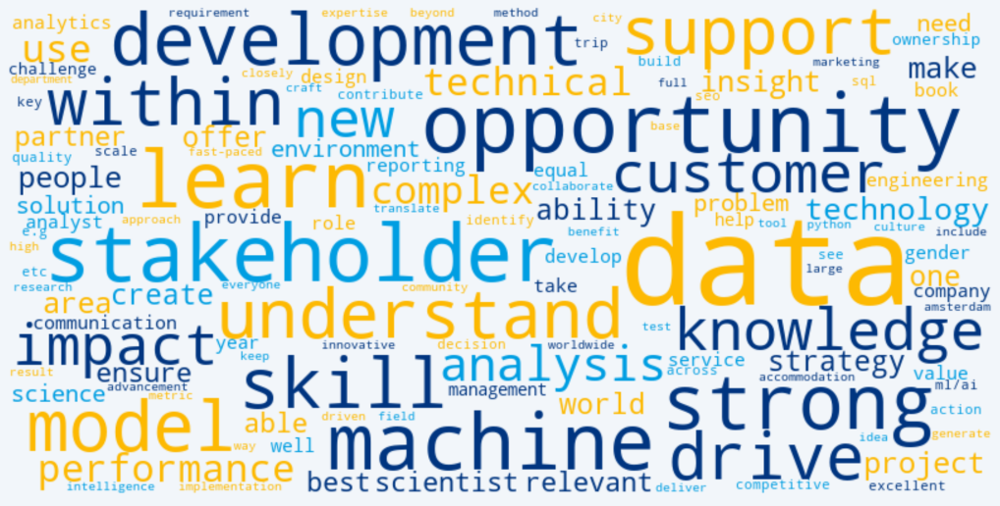

In [73]:
descriptions = ''.join(d for d in df_data['Job Description - Cleaned'])
word_count = dict(Counter(descriptions.split())) #Creating a dictionary of all words in split description
words_popular = {k: v for k, v in sorted(word_count.items(), key=lambda item: item[1], reverse=True)} #Creating dictionary by most popular words by looping over our split descriptions dictionary
words_popular = {k: v for k, v in words_popular.items() if k not in {'experience', 'work', 'team', 'business', 'product', 'booking.com'}} #Removing top 6 words

wordcloud = WordCloud(min_font_size=8, max_font_size=100, max_words=500, width=800, height=400,prefer_horizontal=1, background_color='#f2f6fa').generate_from_frequencies(words_popular) #Generate wordcloud class from dictionary

plt.imshow(wordcloud.recolor(colormap=cmap3), interpolation='bilinear')
plt.axis('off')
plt.show();

##### Inference
> - Only **~5%** of all positions are Data related jobs

## 7.1 Location

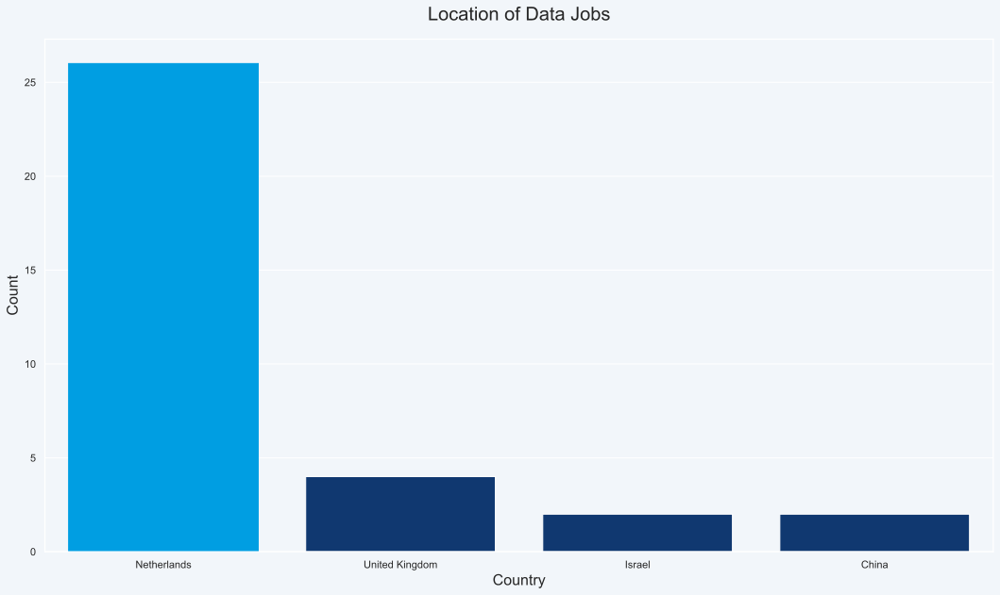

In [74]:
ax = sns.countplot(data=df_data, x='Country', color=blue_d)

for bar in ax.patches:
    if bar.get_x() < 0:
        bar.set_color(blue_l)

plt.xlabel('Country', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.title('Location of Data Jobs', fontsize=20, pad=20);

In [75]:
df_data['Category'] = 0
for i in range(df_data.shape[0]):
    if 'Manager' in df_data['Job Title'][i]:
        df_data['Category'][i] = 'Manager'
    elif 'Machine Learning' in df_data['Job Title'][i]:
        df_data['Category'][i] = 'ML Scientist'
    elif 'Scientist' in df_data['Job Title'][i]:
        df_data['Category'][i] = 'Data Scientist'
    else:
        df_data['Category'][i] = 'Data Analyst'

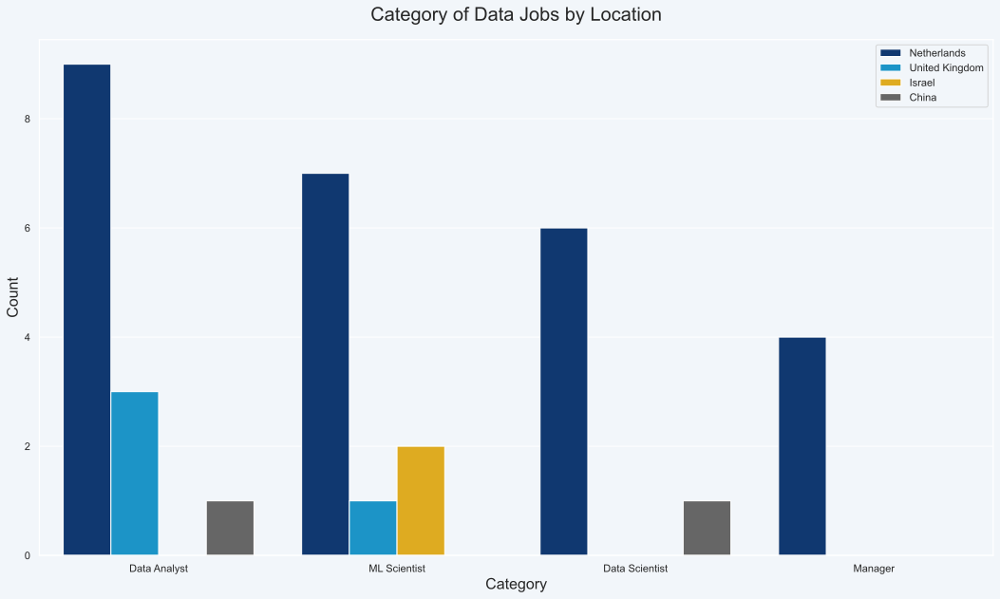

In [76]:
ax = sns.countplot(data=df_data, x='Category', palette=c4, hue='Country', order = df_data['Category'].value_counts().index)

ax.legend(loc=1)
plt.xlabel('Category', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.title('Category of Data Jobs by Location', fontsize=20, pad=20);

##### Inference
> - Amongst all categories, most jobs are based in the Netherlands
> - Manager jobs are exclusive to the Netherlands
> - Machine Learning Scientist jobs are exclusive to Israel, which has no other job positions
> - The UK has no positions for Data Scientists and Managers

## 7.2 Education

In [77]:
education = ['bachelor', 'bachelors','bcs','master', 'masters', 'msc', 'phd']

In [78]:
df_education = pd.concat([df_data,pd.DataFrame(columns = education)]).copy()
df_education[education] = 0

In [79]:
for i in range(df_education.shape[0]): #Looping through all rows of df
    description = df_education['Job Description - Cleaned'][i] #Getting Cleaned Job Description
    for j in range(len(education)): #Looping through dictionary of skills
        if education[j] in description: #Comparing list of skills to words in Job Descriptions
            df_education[education[j]][i] = 1 #Adding 1 to all matches

In [80]:
df_education = df_education[['Category', 'bachelor', 'bachelors','bcs','master', 'masters', 'msc', 'phd']].copy()
df_education['Bachelor'] = df_education[['bachelor', 'bachelors','bcs']].sum(axis=1)
df_education['Master'] = df_education[['master', 'masters', 'msc']].sum(axis=1)
df_education['PhD'] = df_education[['phd']].sum(axis=1)
df_education.drop(columns=education, inplace=True)

In [81]:
df_education = df_education.melt('Category', var_name='cols', value_name='vals')

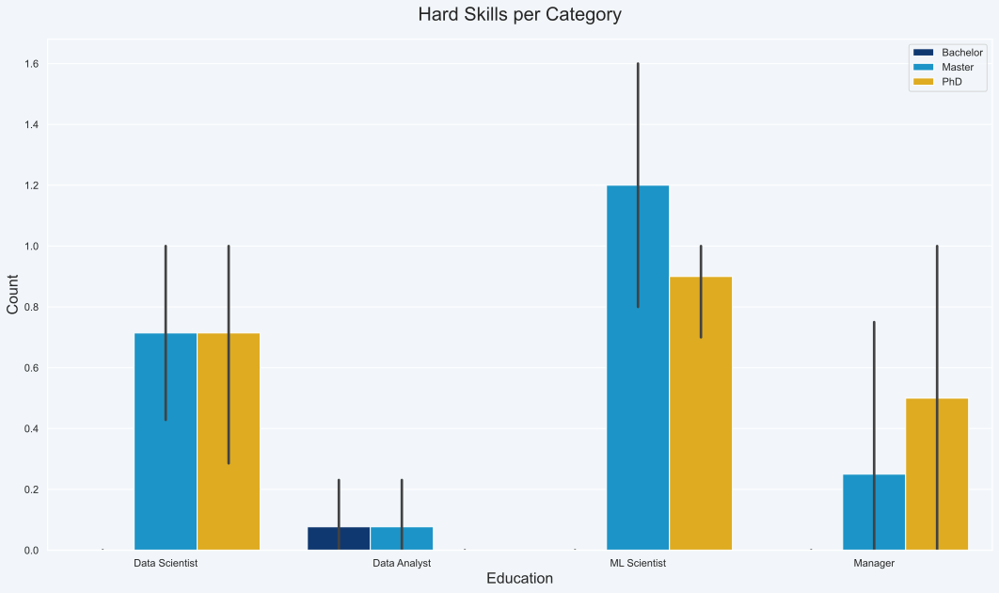

In [82]:
ax = sns.barplot(data=df_education, x='Category', y='vals',palette=c15, hue='cols')

ax.legend(loc=1)
plt.xlabel('Education', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.title('Hard Skills per Category', fontsize=20, pad=20);

##### Inference

> - **Master Degree** in a relevant field is the minimum for most jobs outside of Data Analyst
> - **Master Degree & PhD** are often mentioned together
> - **Bachelor Degree** is only mentioned in Data Analyst roles

## 7.3 Experience

Our initial cleaning efforts also removed most numbers. In order to determine how many years of experience is required for a certain job, we'll extract that infomation from the original dataframe.

In [83]:
#Regex explanation:
#Group 1: (\d+(?:\s*-?\s*\d+)?\+?)
#         \d+ - 1+ digits
#         (?:\s*-?\s*\d+) - Optional group matching '-', any amount of whitespace and then 1+ digits
#         \+? - an optional '+' char
#\s* - 0+ whitespaces
#Group 2: (years?) - year or years
rx = re.compile(r'(\d+(?:\s*-?\s*\d+)?\+?)\s*(years?)', re.I)

df_data['Years of Experience'] = '0'

#Loop through Job Descriptions
for i in range(df_data.shape[0]):
    description = [df_data['Job Description'].iloc[i]]
    for string in description:
        exp_temp = rx.search(string)
        if exp_temp:
            df_data['Years of Experience'][i] = str(exp_temp.groups()[0]) #We choose to focus on minimal years of experience
        else:
            print('{} - not found'.format(df_data['Job Title'][i]))

Data Scientist Insights - Trip Foundations - not found
Team Lead Analytics - Meta Search - not found
Senior Data Analyst - Rides, Manchester - not found
Senior Machine Learning Scientist, FinTech - not found
PhD Machine Learning Research Intern - not found
Data Manager - Customer Insights - Accommodations - not found
Data Analyst-China - not found
Data Scientist Insights - Accommodations - not found


In [84]:
df_data['Years of Experience'] = df_data['Years of Experience'].apply(lambda x: re.split('\D', str(x))[0])
df_data = df_data.drop(columns='Job Description')

In [85]:
df_data['Years of Experience'] = df_data['Years of Experience'].astype(float)

Handling missing values

In [86]:
df_data[df_data['Years of Experience'] == 0]

,Job Title,Job Description - Cleaned,Country,Category,Years of Experience
3,Data Scientist Insights - Trip Foundations,long ago book trip see eiffel tower stroll new york iconic madison avenue feel sand toe copacabana beach complex time consume simply matter tap smartphone fact booking.com make easy everyone experience world world might feel little farther away right busy prepare world ready travel across office worldwide continue innovate solve complex challenge travel technology plan excite development lie ahead strategic long-term investment believe future travel opening new career opportunity strong impa...,Netherlands,Data Scientist,0.0
6,Team Lead Analytics - Meta Search,team leader analytics translates analytics vision strategy execution build strong team within area coach develop analyst independently use expertise technical professional competency spend less time practical analytics work instead empower direct report best work accountable quality analytics work team b.responsible leadership build strong team coach develop individual contributor able prioritize work depend business need keep stakeholder align time translate analytics vision strategy execut...,Netherlands,Data Analyst,0.0
9,"Senior Data Analyst - Rides, Manchester",long ago book trip see eiffel tower stroll new york iconic madison avenue feel sand toe copacabana beach simply matter tap smartphone fact booking.com make easy everyone experience world world might feel little farther away right busy prepare world ready travel across office worldwide continue innovate solve complex challenge travel technology plan excite development lie ahead strategic long-term investment believe future travel opening new career opportunity strong impact mission united bel...,United Kingdom,Data Analyst,0.0
16,"Senior Machine Learning Scientist, FinTech",booking.com data drive decision technology core innovation everywhere company datasets line code a/b test thrill first night new place excitement next morning friend make journey take sight see food sample product partner people make easy everyone experience world role work heavily online data live decisioning product offering book website machine learn scientist technical innovator implementers complete lifecycle production-ready machine learn model machine learn model lifecycle consists hy...,United Kingdom,ML Scientist,0.0
21,PhD Machine Learning Research Intern,machine learn research intern machine learn center booking.com tel aviv pursue phd machine learn related field subject-matter expert theory behind one follow area machine intelligence recommendation system nlp computer vision causality statistic reinforcement learn etc guidance booking.com mentor expertise solve real world problem push boundary state-of-the-art goal publishing work applicant ask attach cv recommendation letter supervisor cv recommendation letter one pdf participation interns...,Israel,ML Scientist,0.0
24,Data Manager - Customer Insights - Accommodations,booking.com data drive decision technology core innovation everywhere company datasets line code a/b test thrill first night new place excitement next morning friend make journey take sight see food sample product partner people make easy everyone experience world customer insight department look data savvy professional join team data scientist opportunity use data generate insight use across various department business help predict understand customer behaviour enable offer relevant persona...,Netherlands,Manager,0.0
27,Data Analyst-China,position summary work autonomously data scientist business stakeholder proactively suggests way achieve team objective actively participates analytics business and/or product team activity standup planning meeting retrospective expect networking within outside department lead support data initiative reporting business intelligence think future need prepares work within team reporting analyst data scientist project base business team cross departmental company pr

##### Data Scientists

In [87]:
DS_mean = float(df_data[(df_data['Category'] == 'Data Scientist')&
                      (df_data['Years of Experience'] > 0)].mean())

df_data.iat[3, 4] = DS_mean
df_data.iat[28,4] = DS_mean

##### Data Analysts

In [88]:
DA_S_mean = float(df_data[(df_data['Category'] == 'Data Analyst')&
                (df_data['Years of Experience'] > 0)&
                (df_data['Job Title'].str.contains('Senior|Lead')==True)].mean())

DA_mean = float((df_data[(df_data['Category'] == 'Data Analyst')&
            (df_data['Years of Experience'] > 0)&
            (df_data['Job Title'].str.contains('Senior|Lead')==False)].mean()))

df_data.iat[6,4] = DA_S_mean
df_data.iat[9,4] = DA_S_mean
df_data.iat[27,4] = DA_mean

In [89]:
df_data[(df_data['Years of Experience'] == 0)]

,Job Title,Job Description - Cleaned,Country,Category,Years of Experience
16,"Senior Machine Learning Scientist, FinTech",booking.com data drive decision technology core innovation everywhere company datasets line code a/b test thrill first night new place excitement next morning friend make journey take sight see food sample product partner people make easy everyone experience world role work heavily online data live decisioning product offering book website machine learn scientist technical innovator implementers complete lifecycle production-ready machine learn model machine learn model lifecycle consists hy...,United Kingdom,ML Scientist,0.0
21,PhD Machine Learning Research Intern,machine learn research intern machine learn center booking.com tel aviv pursue phd machine learn related field subject-matter expert theory behind one follow area machine intelligence recommendation system nlp computer vision causality statistic reinforcement learn etc guidance booking.com mentor expertise solve real world problem push boundary state-of-the-art goal publishing work applicant ask attach cv recommendation letter supervisor cv recommendation letter one pdf participation interns...,Israel,ML Scientist,0.0
24,Data Manager - Customer Insights - Accommodations,booking.com data drive decision technology core innovation everywhere company datasets line code a/b test thrill first night new place excitement next morning friend make journey take sight see food sample product partner people make easy everyone experience world customer insight department look data savvy professional join team data scientist opportunity use data generate insight use across various department business help predict understand customer behaviour enable offer relevant persona...,Netherlands,Manager,0.0


##### Managers

In [90]:
df_data[(df_data['Category'] == 'Manager')&
                      (df_data['Years of Experience'] > 0)]

,Job Title,Job Description - Cleaned,Country,Category,Years of Experience
10,Manager Data and Reporting Services - People Services,manager data reporting service responsible define overall strategy provide people data reporting service effective efficient way right cost ensure optimal experience employee key stakeholder addition she/he drive implementation strategy data produce consume include governance architecture quality order meet evolve business objective technology landscape she/he partner business technology team member people analytics data office support implementation data strategy meeting specific business o...,Netherlands,Manager,8.0
29,Manager Data Science Insights - Flights,flight business one cornerstone connect trip ought offer best convenient flight every customer start trip buying flight complement exist journey flight best inventory available competitive price power site solves pain point book flight today manager data science insight lead team data scientist machine learn scientist data analyst successful candidate able build strong team support team member career development connect well team member provide guidance remove roadblock work closely product ...,Netherlands,Manager,5.0
30,Manager Data Science Insights - Pricing - Accommodations,long ago book trip see eiffel tower stroll new york iconic madison avenue feel sand toe copacabana beach simply matter tap smartphone fact booking.com make easy everyone experience world world might feel little farther away right busy prepare world ready travel across office worldwide continue innovate solve complex challenge travel technology plan excite development lie ahead strategic long-term investment believe future travel opening new career opportunity strong impact mission.we united ...,Netherlands,Manager,3.0


In [91]:
df_data['Job Description - Cleaned'][24]

'booking.com data drive decision technology core innovation everywhere company datasets line code a/b test thrill first night new place excitement next morning friend make journey take sight see food sample product partner people make easy everyone experience world customer insight department look data savvy professional join team data scientist opportunity use data generate insight use across various department business help predict understand customer behaviour enable offer relevant personalise experience customer insight team customer insight mission create competitive advantage building clear understand customer total travel behavior one foundational task deliver create source truth company trip data transactional customer level main project deliver involve connect data different product bring connect trip life data base metric insight create data warehouse apply use case data business cross sell opportunity many come data manager support implementation process data produce consume

Looking at the Job Description we find that it asks for beginner/intermediate knowledge - so we take an educated guess, and assume the minimum years of experience required is 3.

In [92]:
df_data.iat[24,4] = 3

##### Machine Learning Scientists

In [93]:
ML_mean = df_data[(df_data['Category'] == 'ML Scientist')&
                      (df_data['Years of Experience'] > 0)].mean()
df_data.iat[16,4] = ML_mean

We opt to leave the intern position at 0 years.

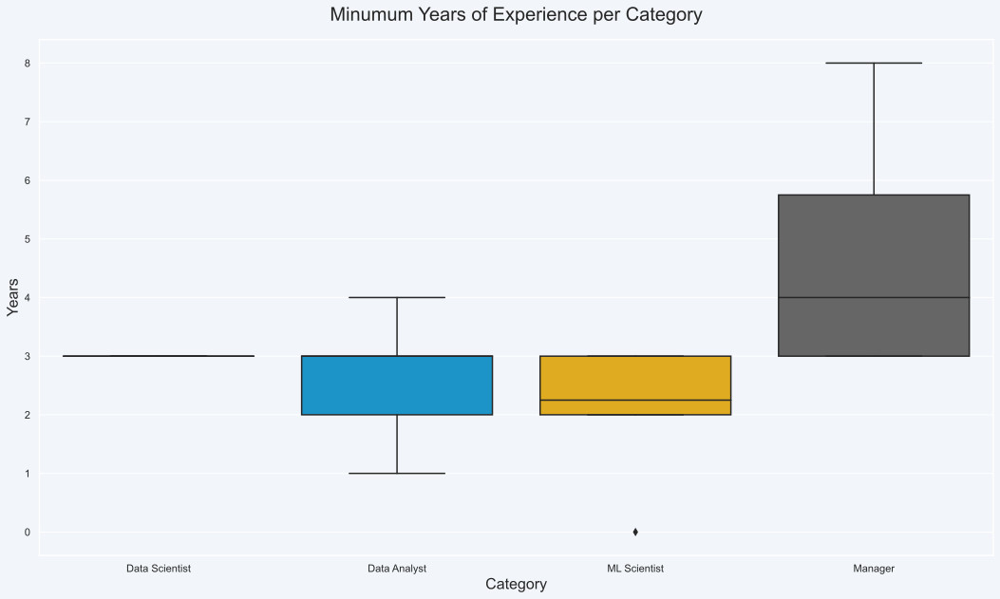

In [94]:
ax = sns.boxplot(data=df_data, x='Category', y='Years of Experience', palette=c4)

plt.xlabel('Category', fontsize=16)
plt.ylabel('Years', fontsize=16)
plt.title('Minumum Years of Experience per Category', fontsize=20, pad=20);

##### Inference
> - Minimum years of experience range from **0 to 8**
> - The lowest required amount of experience is for **Intern** (0 years) and highest for **Manager** (8)
> - All Data Science jobs have 3 years of minimum experience
***
##### Comments
> - It would be more accurate to get the mean from the whole dataset (df), rather than from the smaller subsection, and compare it to other Senior/Lead/Manager roles

## 7.4 Skills

In [95]:
data_list = ['Data Scientist', 'Data Analyst', 'ML Scientist', 'Manager']

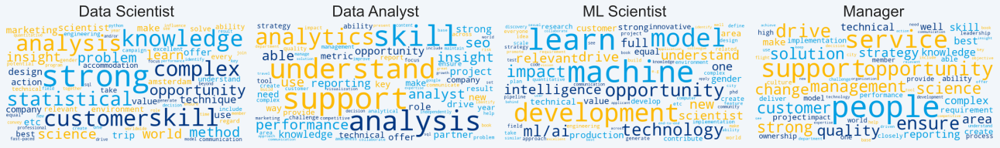

In [96]:
fig = plt.figure(figsize=(18,8))
count = 1
for cat in range(len(data_list)):
    descriptions = ''.join(d for d in df_data[df_data['Category']==data_list[cat]]['Job Description - Cleaned'])
    word_count = dict(Counter(descriptions.split())) #Creating a dictionary of all words in split description
    words_popular = {k: v for k, v in sorted(word_count.items(), key=lambda item: item[1], reverse=True)} #Creating dictionary by most popular words by looping over our split descriptions dictionary
    words_popular = {k: v for k, v in words_popular.items() if k not in {'data', 'stakeholder','experience', 'work', 'team', 'business', 'product', 'booking.com', 'within'}} #Removing common words

    wordcloud = WordCloud(min_font_size=12, max_font_size=100, max_words=500,prefer_horizontal=1,width=800, height=400, background_color='#f2f6fa').generate_from_frequencies(words_popular) #Generate wordcloud class from dictionary

    ax = plt.subplot(1,4, count)

    plt.imshow(wordcloud.recolor(colormap=cmap3), interpolation='bilinear')
    plt.title(data_list[cat], fontsize=20, pad=8)

    ax.imshow(wordcloud)
    ax.axis('off')

    count = count + 1
    
plt.tight_layout(pad=.8)

##### Inference

> - Though overlap exist, we can clearly see identifiable traits/skills for each Job

In [97]:
data_skills = ['python','sql','excel', 'hadoop', 'spark', 'tableau']

In [98]:
df_data = pd.concat([df_data,pd.DataFrame(columns = data_skills)])
df_data[data_skills] = 0

In [99]:
for i in range(df_data.shape[0]): #Looping through all rows of df
    description = df_data['Job Description - Cleaned'][i] #Getting Cleaned Job Description
    for j in range(len(data_skills)): #Looping through dictionary of skills
        if data_skills[j] in description: #Comparing list of skills to words in Job Descriptions
            df_data[data_skills[j]][i] = 1 #Adding 1 to all matches

In [100]:
df_data_num = df_data[['Category', 'python', 'sql', 'excel', 'hadoop', 'spark', 'tableau']].copy()

In [101]:
df_data_num = df_data_num.melt('Category', var_name='cols', value_name='vals')
df_data_num

,Category,cols,vals
0,Data Scientist,python,1
1,Data Scientist,python,1
2,Data Analyst,python,1
3,Data Scientist,python,1
4,ML Scientist,python,1
...,...,...,...
199,Manager,tableau,0
200,Manager,tableau,0
201,Data Analyst,tableau,0
202,ML Scientist,tableau,0


In [102]:
df_data_num.groupby(by='cols').sum().sort_values(by='vals',ascending=False)

,vals
cols,
sql,30
excel,26
python,25
hadoop,21
spark,16
tableau,8


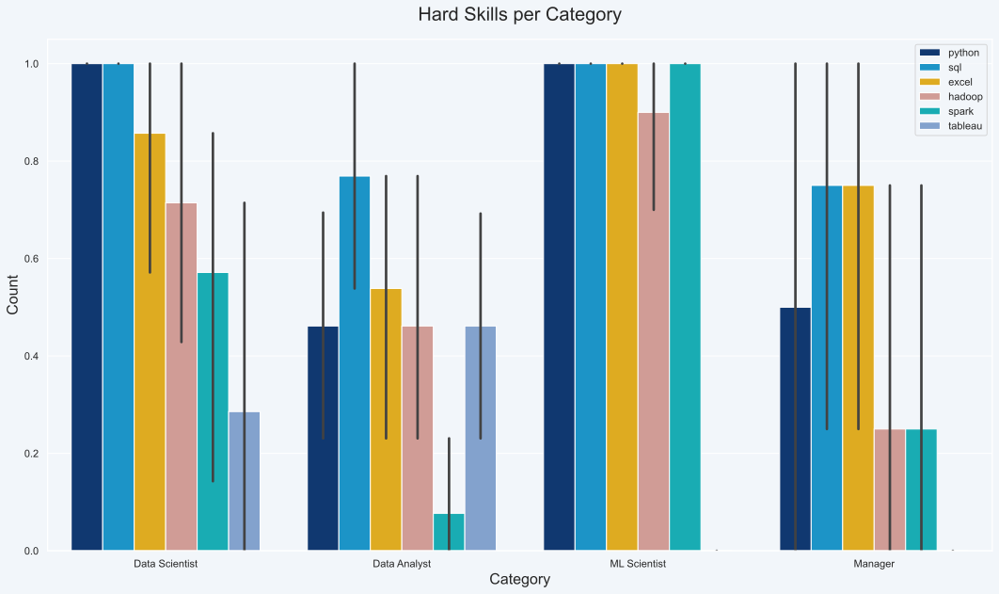

In [103]:
ax = sns.barplot(data=df_data_num, x='Category', y='vals',palette=c15, hue='cols')

ax.legend(loc=1)
plt.xlabel('Category', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.title('Hard Skills per Category', fontsize=20, pad=20);

##### Inference

> - **SQL** (30) is the most in demand (hard) skill, followed by **Excel** (26) and **Python** (25)
> - **Hadoop** (21) and **Spark** (16) are also in demand, mostly in Data Science and Machine Learning
> - **Tableau** (8) is only asked for Data Science & Analytics
> - Manager skills fall overlap with one of the other categories (e.g. Manager Machine Learning), which explains the high variance

***

# 8. Modeling

In order to improve our 45% accurate correct prediction rate from earlier, we'll utilize more advanced techniques of classification. The goal (and challenge) here is to increase our score by using only the Job Description as input - returning the Team as output. Broadly, we take the following steps:

- **Step 1:** Because most algorithms have difficulty understand text we start by encoding out features, transforming them from text to numbers.
- **Step 2:** We split the dataset into a train and test set, so we can estimate our performance.
- **Step 3:** We compare different classifiers and evaluate them to see which ones to use for this problem.
- **Step 4:** In order to find the best parameters for our classifiers, we repeatedly run it with different settings.
- **Step 5:** To see if we have over-fitted our classifiers, we plot a Learning curves.
- **Step 6:** By combining different models, we hope to improve overall performance.
- **Step 7:** We make a prediction and see what we've learned.

### 8.1 Imports

In [153]:
#Preprocessing
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.model_selection import train_test_split, KFold, cross_validate, cross_val_score, GridSearchCV, StratifiedKFold, learning_curve
from sklearn.feature_selection import SelectFromModel
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import LabelEncoder, Normalizer
from sklearn.pipeline import Pipeline, make_pipeline

from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, ExtraTreesClassifier, VotingClassifier
from sklearn.decomposition import TruncatedSVD

from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier

### 8.2 Encoding Categorical Column Team

In [105]:
encoder = LabelEncoder()
y = encoder.fit_transform(df.loc[:,['Team']])
X = df['Job Description - Cleaned'].values

### 8.3 Splitting Dataset

In [106]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

In [107]:
y_train = y_train.reshape(-1,1)
y_test = y_test.reshape(-1,1)

In [108]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(522,)
(522, 1)
(131,)
(131, 1)


### 8.4 LSA

The term frequency inverse document frequency (TFIDF) is a more reliable metric than plain frequency because it normalizes frequency across documents. Very common (and semantically meaningless) words like articles (‘the’, ‘a’, ‘an’) and prepositions are given less weight and filtered out.

TruncatedSVD implements a variant of singular value decomposition (SVD) that only computes the k largest singular values, where k is a user-specified parameter.

When truncated SVD is applied to term-document matrices (as returned by TfidfVectorizer), this transformation is known as latent semantic analysis (LSA), because it transforms such matrices to a “semantic” space of low dimensionality.

In particular, LSA is known to combat the effects of synonymy and polysemy (both of which roughly mean there are multiple meanings per word), which cause term-document matrices to be overly sparse and exhibit poor similarity under measures such as cosine similarity.

In [109]:
#Make LSA features
word_vectorizer = TfidfVectorizer(
    sublinear_tf=True,
    strip_accents='unicode',
    analyzer='word',
    ngram_range=(1, 2),
    token_pattern=r'\w{2,}',
    max_df=.95,
    min_df=0.01
    )

X_train = word_vectorizer.fit_transform(X_train)
X_test = word_vectorizer.transform(X_test)

svd = TruncatedSVD(n_components=200)
normalizer = Normalizer(copy=False)

lsa = make_pipeline(svd, normalizer)

X_train = lsa.fit_transform(X_train)
X_test = lsa.transform(X_test)

Explained variance of the SVD: 85%


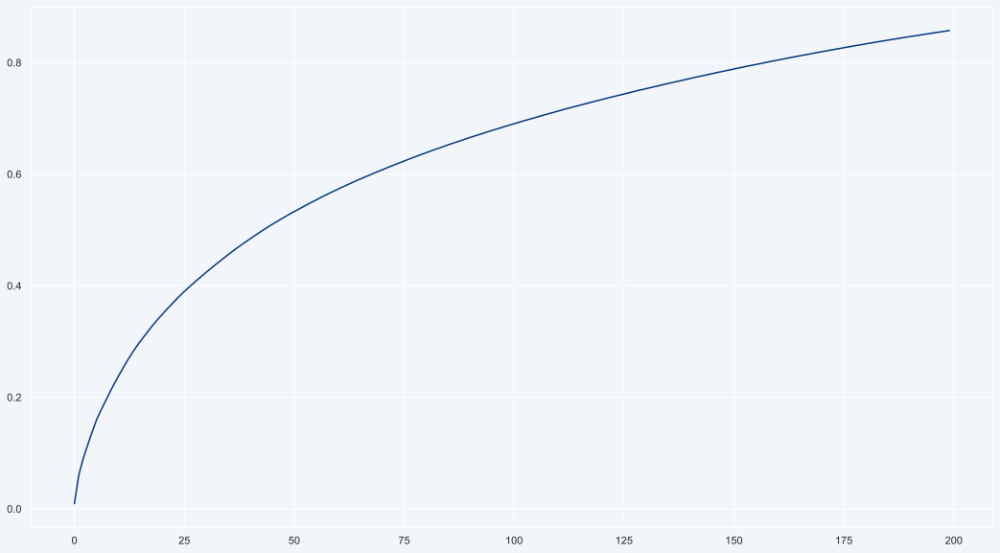

In [110]:
plt.plot(np.cumsum(svd.explained_variance_ratio_))
print('Explained variance of the SVD: {}%'.format(int(svd.explained_variance_ratio_.sum() * 100)))

### 8.5 Cross Validate Models

In [150]:
kfold = StratifiedKFold(n_splits=10)

In [151]:
SEED = 42

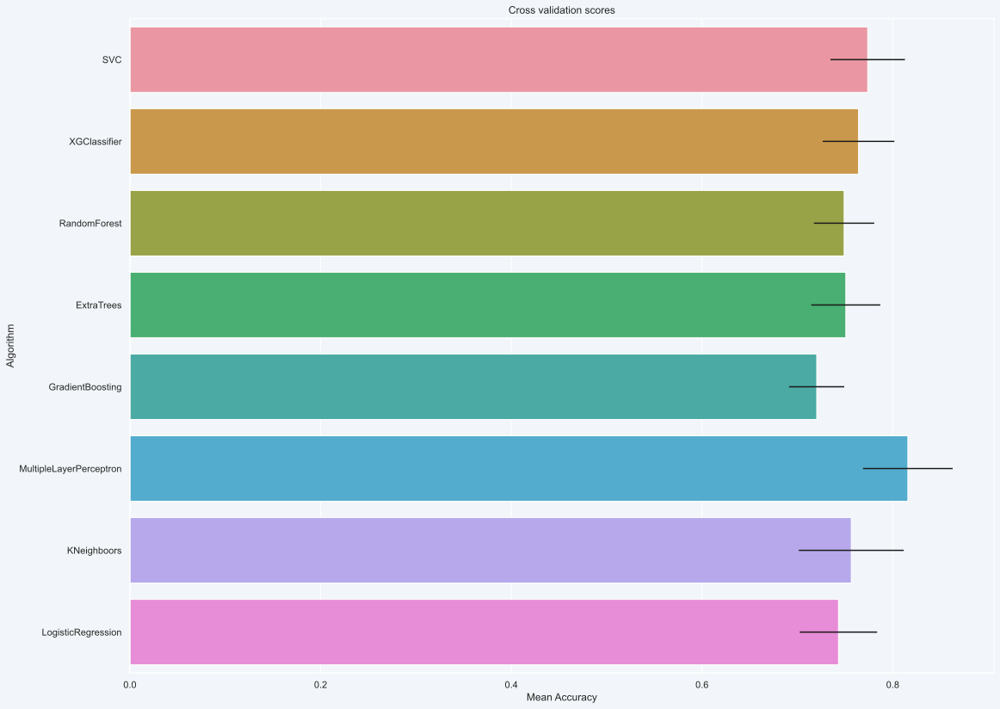

In [155]:
# Modeling differents algorithms 
classifiers = []
classifiers.append(SVC(random_state=SEED))
classifiers.append(XGBClassifier(random_state=SEED))
classifiers.append(RandomForestClassifier(random_state=SEED))
classifiers.append(ExtraTreesClassifier(random_state=SEED))
classifiers.append(GradientBoostingClassifier(random_state=SEED))
classifiers.append(MLPClassifier(random_state=SEED))
classifiers.append(KNeighborsClassifier())
classifiers.append(LogisticRegression(random_state = SEED))

cv_results = []
for classifier in classifiers :
    cv_results.append(cross_val_score(classifier, X_train, y = y_train, scoring = 'accuracy', cv = kfold, n_jobs=4))

cv_means = []
cv_std = []
for cv_result in cv_results:
    cv_means.append(cv_result.mean())
    cv_std.append(cv_result.std())

cv_res = pd.DataFrame({'CrossValMeans':cv_means,'CrossValerrors': cv_std,'Algorithm':['SVC','XGClassifier',
'RandomForest','ExtraTrees','GradientBoosting','MultipleLayerPerceptron','KNeighboors','LogisticRegression']})

fig = plt.figure(figsize=(18,14))

g = sns.barplot('CrossValMeans','Algorithm',data = cv_res,palette = c15, orient = 'h',**{'xerr':cv_std})
g.set_xlabel('Mean Accuracy')
g = g.set_title('Cross validation scores')

### 8.6 Hyperparameter tuning best models

Here we choose 6 models that performed best in CV

In [156]:
#SVC Classifier
SVC = SVC(probability=True,random_state=SEED)

#Search grid for optimal parameters
svc_param_grid = { 'C': [1, 10, 100], 
                    'kernel': ['linear', 'rbf'],
                    'gamma':[0.01, 0.001]
                    }

gsSVC = GridSearchCV(SVC,param_grid = svc_param_grid, cv=kfold, scoring='accuracy', n_jobs= -1, verbose = 1)

gsSVC.fit(X_train,y_train)

gsSVC_best = gsSVC.best_estimator_

#Best score
gsSVC.best_score_

Fitting 10 folds for each of 12 candidates, totalling 120 fits


0.8253265602322207

In [157]:
gsSVC.best_params_

{'C': 100, 'gamma': 0.01, 'kernel': 'rbf'}

In [121]:
'''#XGBoostClassifier
XGBC = XGBClassifier(random_state=SEED)

#Search grid for optimal parameters
xgbc_param_grid = { 'n_estimators': [500],
                    'learning_rate': [0.01,0.1],
                    'booster': ['gbtree'],
                    'gamma': [0, 1],
                    'reg_alpha': [0,1],
                    'reg_lambda': [0,5],
                    'base_score': [0.2,0.5]
                  }

gsXGBC = GridSearchCV(XGBC,param_grid = xgbc_param_grid, cv=kfold, scoring='accuracy', n_jobs= -1, verbose = 1)

gsXGBC.fit(X_train,y_train)

gsXGBC_best = gsXGBC.best_estimator_

#Best score
gsXGBC.best_score_'''

Fitting 5 folds for each of 32 candidates, totalling 160 fits


KeyboardInterrupt: 

In [ ]:
#gsXGBC.best_params_

In [122]:
#Random Forest 
RFC = ExtraTreesClassifier()

## Search grid for optimal parameters
rfc_param_grid = {'max_depth': [None],
                  'max_features': [100],
                  'min_samples_split': [2],
                  'min_samples_leaf': [1],
                  'bootstrap': [False],
                  'n_estimators': [100,500],
                  'criterion': ['gini', 'entropy']
                 }

gsRFC = GridSearchCV(RFC,param_grid = rfc_param_grid, cv=kfold, scoring='accuracy', n_jobs= -1, verbose = 1)

gsRFC.fit(X_train,y_train)

gsRFC_best = gsRFC.best_estimator_

#Best score
gsRFC.best_score_

Fitting 5 folds for each of 4 candidates, totalling 20 fits


0.7662820512820512

In [123]:
gsRFC.best_params_

{'bootstrap': False,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': 100,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 500}

In [125]:
#ExtraTrees 
ETC = ExtraTreesClassifier()

## Search grid for optimal parameters
etc_param_grid = {'max_depth': [None],
                  'max_features': [100],
                  'min_samples_split': [2],
                  'min_samples_leaf': [1],
                  'bootstrap': [False],
                  'n_estimators': [100,500],
                  'criterion': ['gini', 'entropy']
                 }

gsETC = GridSearchCV(ETC,param_grid = etc_param_grid, cv=kfold, scoring='accuracy', n_jobs= -1, verbose = 1)

gsETC.fit(X_train,y_train)

ETC_best = gsETC.best_estimator_

#Best score
gsETC.best_score_

Fitting 5 folds for each of 4 candidates, totalling 20 fits


0.7758241758241758

In [126]:
gsETC.best_params_

{'bootstrap': False,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': 100,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 500}

In [127]:
#MultiLayer Perceptron 
MLPC = MLPClassifier()

## Search grid for optimal parameters
mlpc_param_grid = { 'hidden_layer_sizes': [(50,50,50), (100,)],
                    'max_iter': [50, 100],
                    'activation': ['relu'],
                    'solver': ['lbfgs', 'adam'],
                    'alpha': [0.0001, 0.05],
                    'learning_rate': ['adaptive']
                  }

gsMLPC = GridSearchCV(MLPC,param_grid = mlpc_param_grid, cv=kfold, scoring='accuracy', n_jobs= -1, verbose = 1)

gsMLPC.fit(X_train,y_train)

MLPC_best = gsETC.best_estimator_

#Best score
gsMLPC.best_score_

Fitting 5 folds for each of 16 candidates, totalling 80 fits


0.8044871794871795

In [128]:
gsMLPC.best_params_

{'activation': 'relu',
 'alpha': 0.05,
 'hidden_layer_sizes': (100,),
 'learning_rate': 'adaptive',
 'max_iter': 100,
 'solver': 'lbfgs'}

In [148]:
#K-Nearest Neighbors
KNN = KNeighborsClassifier()

## Search grid for optimal parameters
knn_param_grid = {  'n_neighbors':list(range(1,30,1)),
                    'leaf_size':list(range(1,5,1)),
                    'weights': ['distance']
                    }

gsKNN = GridSearchCV(KNN,param_grid = knn_param_grid, cv=kfold, scoring='accuracy', n_jobs= -1, verbose = 1)

gsKNN.fit(X_train,y_train)

KNN_best = gsETC.best_estimator_

#Best score
gsKNN.best_score_

Fitting 5 folds for each of 116 candidates, totalling 580 fits


/Users/niekvanderzwaag/opt/anaconda3/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/niekvanderzwaag/opt/anaconda3/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/niekvanderzwaag/opt/anaconda3/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/niekvanderzwaag/opt/anaconda3/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-

/Users/niekvanderzwaag/opt/anaconda3/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/niekvanderzwaag/opt/anaconda3/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/niekvanderzwaag/opt/anaconda3/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/niekvanderzwaag/opt/anaconda3/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-

/Users/niekvanderzwaag/opt/anaconda3/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/niekvanderzwaag/opt/anaconda3/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/niekvanderzwaag/opt/anaconda3/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/niekvanderzwaag/opt/anaconda3/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-

0.7892307692307692

In [139]:
gsKNN.best_params_

{'leaf_size': 1, 'n_neighbors': 6, 'weights': 'distance'}

### 8.7 Plotting Learning Curve

/Users/niekvanderzwaag/opt/anaconda3/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/niekvanderzwaag/opt/anaconda3/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/niekvanderzwaag/opt/anaconda3/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/Users/niekvanderzwaag/opt/anaconda3/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-

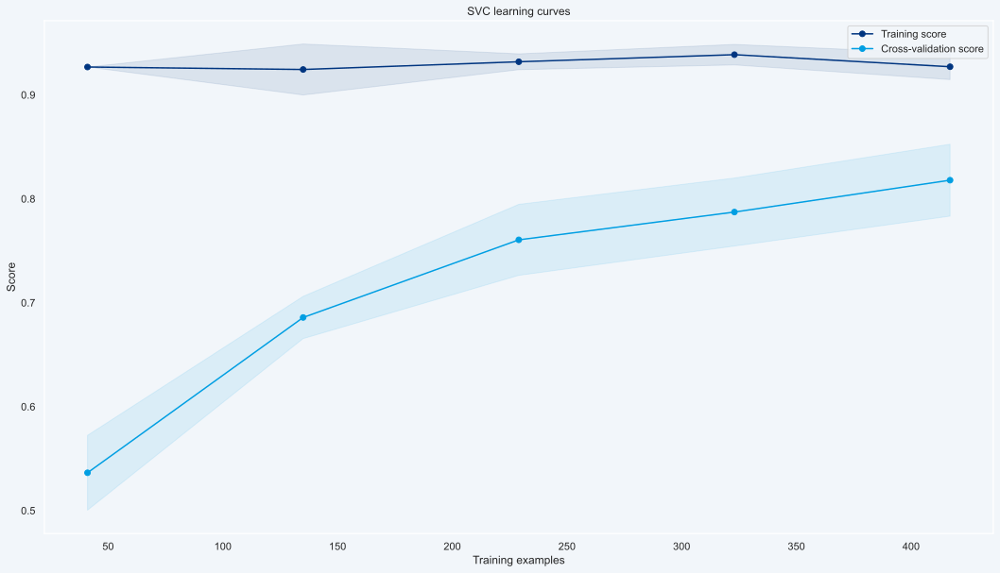

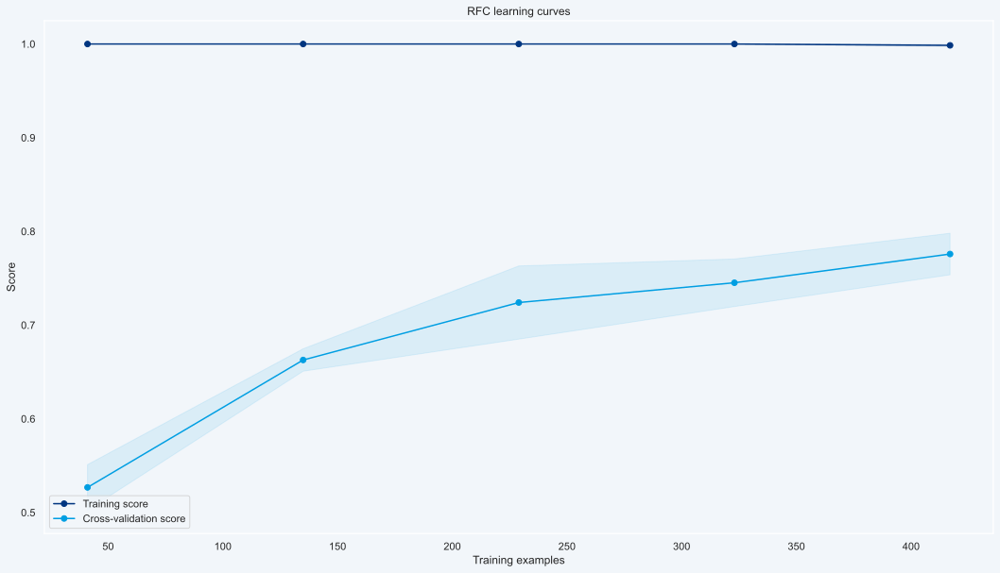

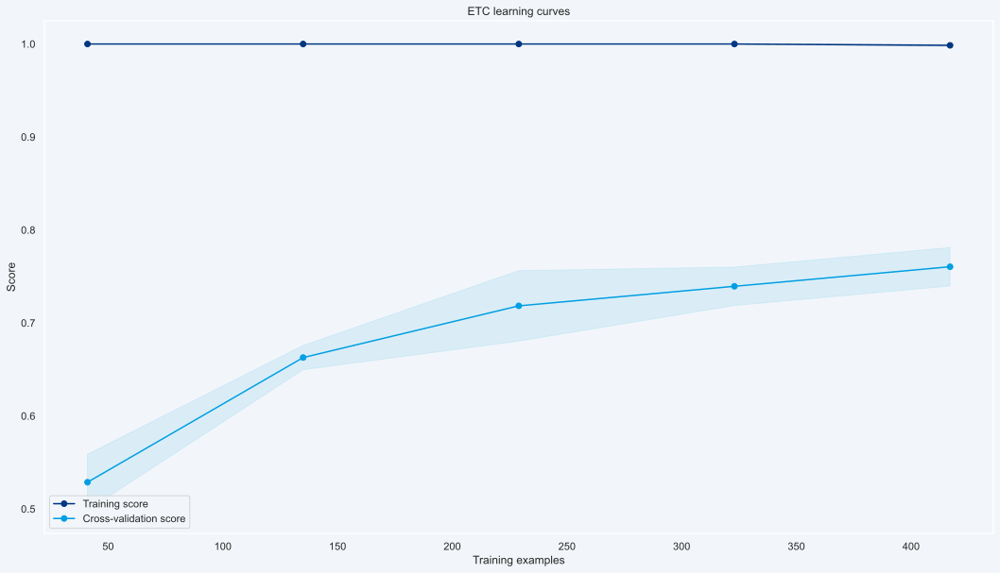

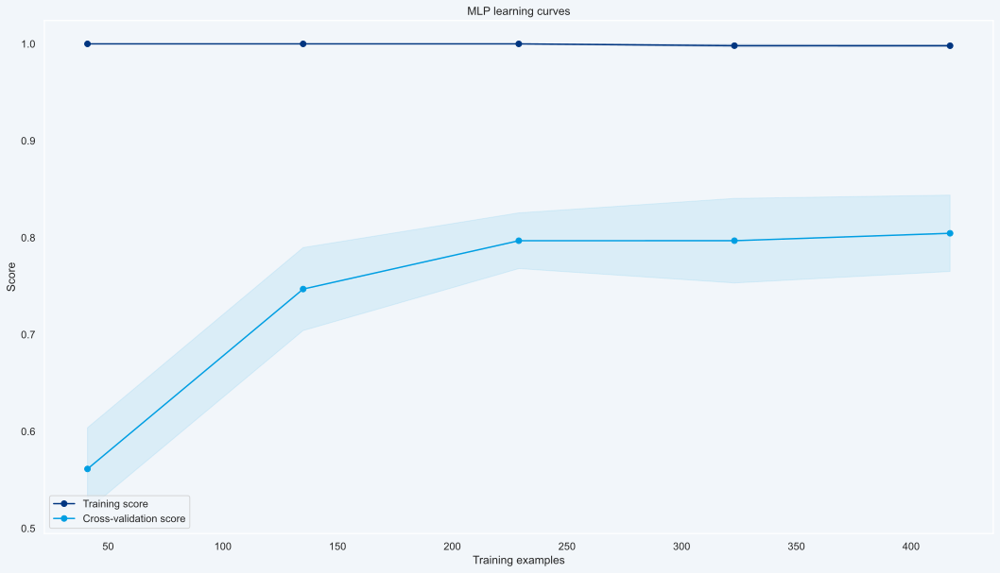

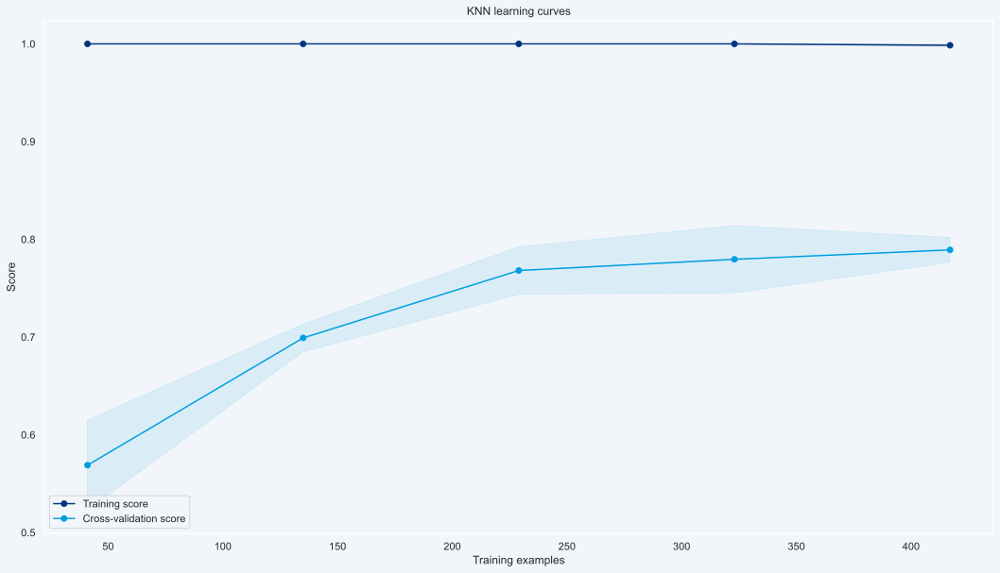

In [149]:
def plot_learning_curve(estimator, title, X, y, ylim=None, cv=None,
                        n_jobs=-1, train_sizes=np.linspace(.1, 1.0, 5)):
    '''Generate a simple plot of the test and training learning curve'''
    plt.figure()
    plt.title(title)
    if ylim is not None:
        plt.ylim(*ylim)
    plt.xlabel('Training examples')
    plt.ylabel('Score')
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    plt.grid()

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color=blue_d)
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1, color=blue_l)
    plt.plot(train_sizes, train_scores_mean, 'o-', color=blue_d,
             label='Training score')
    plt.plot(train_sizes, test_scores_mean, 'o-', color=blue_l,
             label='Cross-validation score')

    plt.legend(loc='best')
    return plt

g = plot_learning_curve(gsSVC.best_estimator_,'SVC learning curves',X_train,y_train,cv=kfold)
#g = plot_learning_curve(gsXGBC.best_estimator_,'XGB learning curves',X_train,y_train,cv=kfold)
g = plot_learning_curve(gsRFC.best_estimator_,'RFC learning curves',X_train,y_train,cv=kfold)
g = plot_learning_curve(gsETC.best_estimator_,'ETC learning curves',X_train,y_train,cv=kfold)
g = plot_learning_curve(gsMLPC.best_estimator_,'MLP learning curves',X_train,y_train,cv=kfold)
g = plot_learning_curve(gsKNN.best_estimator_,'KNN learning curves',X_train,y_train,cv=kfold)

### 8.8 Ensemble Modeling

In [172]:
votingC = VotingClassifier(estimators=[ ('SVC', gsSVC_best),
                                        #('XGBC', gsXGBC_best),
                                        #('RFC', gsRFC_best),
                                        ('ETC', ETC_best),
                                        #('MLP', MLPC_best),
                                        #('KNN',KNN_best)], 
                                      ],voting='soft', 
                                        n_jobs=4)

votingC = votingC.fit(X_train, y_train)

### 8.9 Predictions

In [177]:
y_pred_xxx = gsSVC_best.predict(X_test)

In [173]:
y_pred = votingC.predict(X_test)

In [174]:
'''predicted = encoder.inverse_transform(y_pred)
true = encoder.inverse_transform(y_test).reshape(1,-1).flatten()'''

'predicted = encoder.inverse_transform(y_pred)\ntrue = encoder.inverse_transform(y_test).reshape(1,-1).flatten()'

In [175]:
'''df_results = pd.DataFrame({'True Values': true, 'Predicted Values': predicted})
df_results'''

"df_results = pd.DataFrame({'True Values': true, 'Predicted Values': predicted})\ndf_results"

In [178]:
print(classification_report(y_test, y_pred_xxx))
print(accuracy_score(y_test,y_pred_xxx))

              precision    recall  f1-score   support

           0       0.87      0.95      0.91        21
           1       1.00      0.80      0.89         5
           2       0.60      0.75      0.67         4
           3       0.88      1.00      0.93         7
           4       0.94      0.85      0.89        34
           5       1.00      0.50      0.67         2
           6       1.00      0.80      0.89         5
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         7
           9       0.50      1.00      0.67         1
          10       0.80      0.67      0.73         6
          11       0.88      1.00      0.94        22
          12       0.83      0.62      0.71         8
          13       0.89      1.00      0.94         8

    accuracy                           0.89       131
   macro avg       0.87      0.85      0.85       131
weighted avg       0.89      0.89      0.88       131

0.8854961832061069


no XGB 0.8702290076335878
no XGB/RFC 0.8702290076335878

##### Inference

> - Due to the small size of this dataset we tend to have vastly overfitted models
> - We can predict our target with moderate success using only Job Description texts

### Final thoughts

This was mainly an exercise in working with text and exploring ensemble modeling. I learned a lot along the way, and I **look forward to hearing your comments on how I might improve.**

***

# 9. Acknowledgment & Inspirations

https://github.com/toebR/Tidy-Tuesday/tree/master/hiking - Absolutely stunning visualizations and huge inspiration. The Radar plots in this kernel are translated Python code originating from his project on Hiking Locations in Washington state.

https://www.kaggle.com/yassineghouzam/titanic-top-4-with-ensemble-modeling - The basis of ensemble modeling shown here can be found in this insightful and inspiring kernel by Yassine Ghouzam (@yassineghouzam)

https://www.kaggle.com/tilii7/hyperparameter-grid-search-with-xgboost - Learned a lot from this kernel on Hyperparameter tuning with Grid Search by Tilii (@tilii7)

https://www.kaggle.com/prashant111/a-guide-on-xgboost-hyperparameters-tuning - In-depth look into XGBoost Hyperparameters by Prashant Banerjee (@prashant111)

https://www.kaggle.com/adamschroeder/countvectorizer-tfidfvectorizer-predict-comments - Great explanation on TD-IDF Vecorization by def love(x): (@adamschroeder)

https://vitalv.github.io/projects/doc-clustering-topic-modeling.html - Great explanation on LSA